<a href="https://colab.research.google.com/github/Dr3dre/Bachelor-Degree/blob/main/Anomaly_Detection_on_Wine_Grapes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


### Data

In [2]:
from PIL import Image
from torch.utils.data import Dataset
import numpy as np

class CanopiesDataset(Dataset):
    def __init__(self, image_names, transform):

        self.image_names = image_names
        self.transform = transform

    def __len__(self):

        return len(self.image_names)

    def __getitem__(self, idx):

        image = np.array(Image.open(self.image_names[idx]).convert("RGB"))

        if self.transform:
            image = self.transform(image)

        if "good" in self.image_names[idx]:
            label = 0
        else:
            label = 1

        return image, label

In [3]:
from torch.utils.data import DataLoader

import os
import random

def get_image_paths(data_dir):
    return [os.path.join(data_dir, image_name) for image_name in os.listdir(data_dir) if image_name.endswith(".jpg")]


def get_images_by_scale(data_dir, scale):

    good_dir = os.path.join(data_dir, "good")
    good_dir_1 = os.path.join(good_dir, "scale_1")
    good_dir_1_5 = os.path.join(good_dir, "scale_1.5")
    good_dir_2 = os.path.join(good_dir, "scale_2")

    good_images = []

    if scale == 1 or scale == None:
        good_images += get_image_paths(good_dir_1)

    if scale == 1.5 or scale == None:
        good_images += get_image_paths(good_dir_1_5)

    if scale == 2 or scale == None:
        good_images += get_image_paths(good_dir_2)


    bad_dir = os.path.join(data_dir, "bad")
    bad_dir_1 = os.path.join(bad_dir, "scale_1")
    bad_dir_1_5 = os.path.join(bad_dir, "scale_1.5")
    bad_dir_2 = os.path.join(bad_dir, "scale_2")

    bad_images = []

    if scale == 1 or scale is None:
        bad_images += get_image_paths(bad_dir_1)

    if scale == 1.5 or scale is None:
        bad_images += get_image_paths(bad_dir_1_5)

    if scale == 2 or scale is None:
        bad_images += get_image_paths(bad_dir_2)

    return good_images, bad_images


def split_images_aux(images, train_percentage, val_percentage, train_limit, random_seed):

    train_images = images[: int(len(images) * train_percentage)]
    if train_limit is not None:
        train_images = train_images[: train_limit]

    val_images = images[
        int(len(images) * train_percentage) :
        int(len(images) * (train_percentage + val_percentage))
    ]

    test_images = images[
        int(len(images) * (train_percentage + val_percentage)) :
    ]

    return train_images, val_images, test_images


def split_images(good_images, bad_images, train_percentage, val_percentage, train_limit, random_seed):

    train_images = []
    val_images = []
    test_images = []

    train_images_good, val_images_good, test_images_good = split_images_aux(good_images, train_percentage, val_percentage, train_limit, random_seed)
    train_images_bad, val_images_bad, test_images_bad = split_images_aux(bad_images, train_percentage, val_percentage, train_limit, random_seed)

    train_images += train_images_good
    train_images += train_images_bad

    if random_seed is not None:
        random.seed(random_seed)
        random.shuffle(train_images)

    val_images += val_images_good
    val_images += val_images_bad

    test_images += test_images_good
    test_images += test_images_bad

    print(f"Good images for training: {len(train_images)}")
    print(f"Good images for validation: {len(val_images)}")
    print(f"Good images for testing: {len(test_images)}")

    print(f"Bad images for training: {len(train_images_bad)}")
    print(f"Bad images for validation: {len(val_images_bad)}")
    print(f"Bad images for testing: {len(test_images_bad)}")

    return train_images, val_images, test_images

def get_datasets(train_images, val_images, test_images, transform):

    train_dataset = CanopiesDataset(
        image_names = train_images,
        transform = transform
    )

    val_dataset = CanopiesDataset(
        image_names = val_images,
        transform = transform
    )

    test_dataset = CanopiesDataset(
        image_names = test_images,
        transform = transform
    )

    return train_dataset, val_dataset, test_dataset

def get_loaders_(train_dataset, val_dataset, test_dataset, batch_size, num_workers):

    train_loader = DataLoader(
        train_dataset,
        batch_size = batch_size,
        num_workers = num_workers,
        shuffle = True
    )

    val_loader = DataLoader(
        val_dataset,
        batch_size = batch_size,
        num_workers = num_workers,
        shuffle = False
    )

    test_loader = DataLoader(
        test_dataset,
        batch_size = batch_size,
        num_workers = num_workers,
        shuffle = True
    )

    return train_loader, val_loader, test_loader


def get_loaders(data_dir,
                batch_size,
                train_percentage = 0.7,
                val_percentage = 0.2,
                train_limit = None,
                transform = None,
                num_workers = 2,
                random_seed = 42,
                scale = None):

    good_images, bad_images = get_images_by_scale(data_dir, scale)

    train_images, val_images, test_images = split_images(good_images, bad_images, train_percentage, val_percentage, train_limit, random_seed)

    train_dataset, val_dataset, test_dataset = get_datasets(train_images, val_images, test_images, transform)

    train_loader, val_loader, test_loader = get_loaders_(train_dataset, val_dataset, test_dataset, batch_size, num_workers)

    return train_loader, val_loader, test_loader, train_dataset, val_dataset

In [4]:
# print stats of dataset

import torch
import torchvision

DATA_DIR = "/content/drive/MyDrive/first_dataset"
MODELS_DIR = "/content/drive/MyDrive/canopies_models"
DEVICE = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

BATCH_SIZE = 32
NUM_WORKERS = 2

transform = torchvision.transforms.Compose(
    [
        torchvision.transforms.ToTensor(),
    ]
)

train_loader, val_loader, test_loader, train_dataset, valid_dataset = get_loaders(
        data_dir = DATA_DIR,
        batch_size = BATCH_SIZE,
        train_percentage=0.7,
        val_percentage=0.1,
        transform=transform,
        num_workers=NUM_WORKERS,
        train_limit=None,
        random_seed=42,
        scale = 1.5
    )

Good images for training: 278
Good images for validation: 39
Good images for testing: 81
Bad images for training: 75
Bad images for validation: 11
Bad images for testing: 22


#### Normalization

In [5]:
# calcolo media e standard deviation per normalizzare

def batch_mean_and_sd(loader):

    cnt = 0
    fst_moment = torch.empty(3)
    snd_moment = torch.empty(3)

    for images, _ in loader:
        b, c, h, w = images.shape
        nb_pixels = b * h * w
        sum_ = torch.sum(images, dim=[0, 2, 3])
        sum_of_square = torch.sum(images ** 2,
                                  dim=[0, 2, 3])
        fst_moment = (cnt * fst_moment + sum_) / (
                      cnt + nb_pixels)
        snd_moment = (cnt * snd_moment + sum_of_square) / (
                            cnt + nb_pixels)
        cnt += nb_pixels

    mean, std = fst_moment, torch.sqrt(
      snd_moment - fst_moment ** 2)
    return mean, std

mean, std = batch_mean_and_sd(train_loader)
print("mean and std: \n", mean, std)

mean and std: 
 tensor([0.4132, 0.3744, 0.2791]) tensor([0.1887, 0.1835, 0.1921])


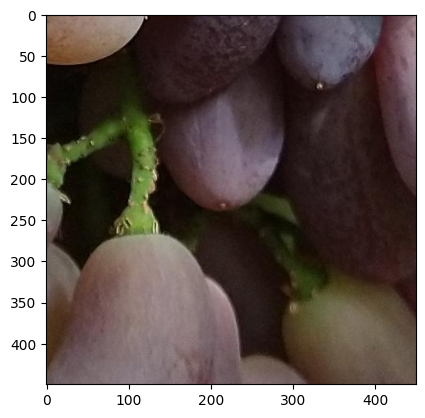

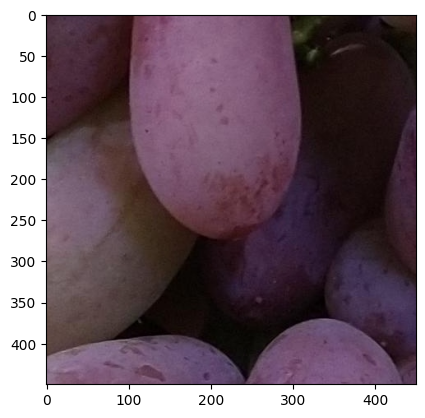

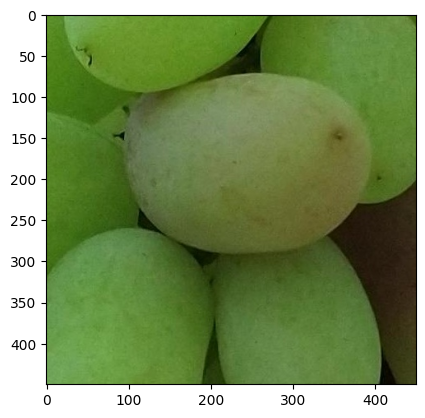

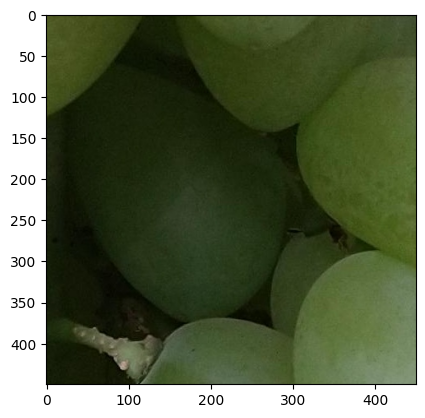

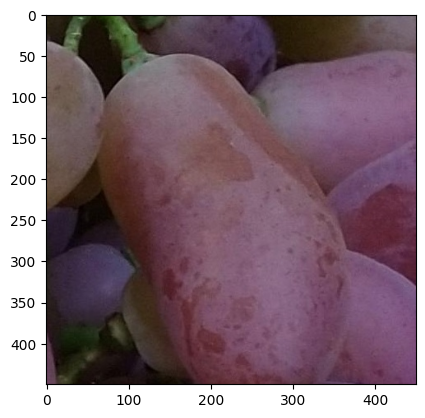

In [6]:
# Python code to visualize an image

import matplotlib.pyplot as plt

transform_NORMALIZED = torchvision.transforms.Compose(
    [
        torchvision.transforms.Normalize(mean = mean, std = std)
    ]
)

images, labels = next(iter(val_loader))

def display_image(images, limit=0):
  images_np = images.numpy()
  img_plt = images_np.transpose(0,2,3,1)

  num_images = limit if limit > 0 else images.shape[0]

  for i in range(num_images):
    plt.imshow(img_plt[i])
    plt.show()

display_image(images, limit=5)

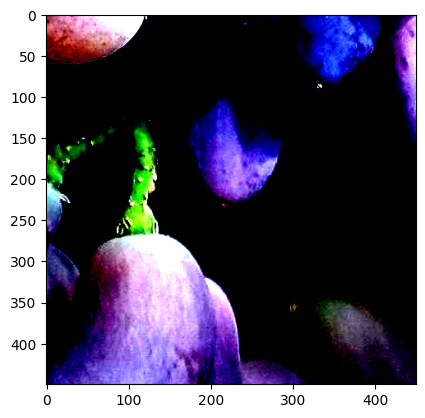

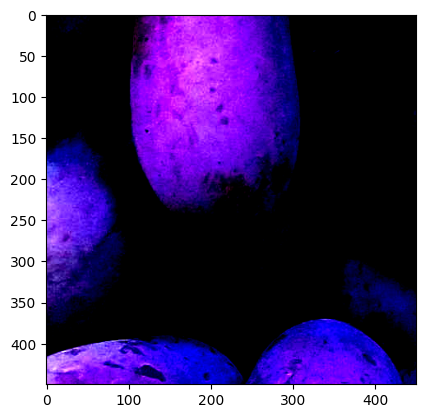

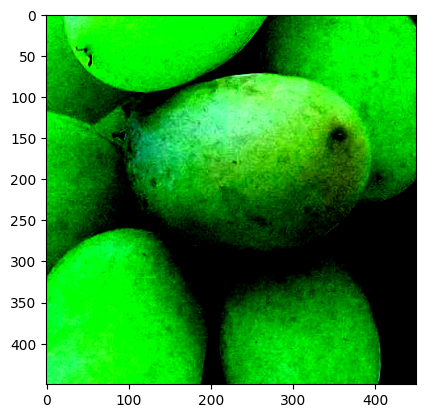

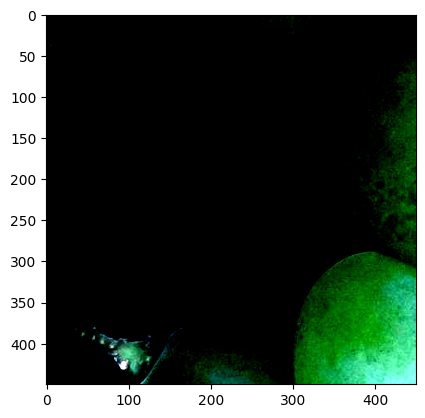

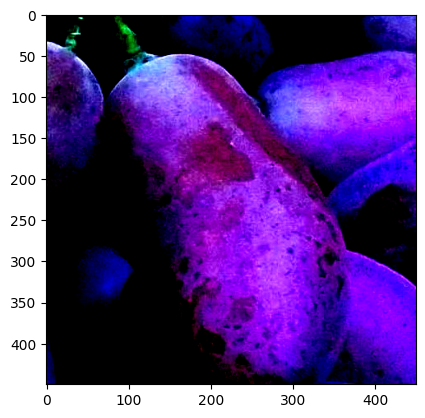

In [7]:
image_norm = transform_NORMALIZED(images)

display_image(image_norm, 5)

#### Data Augmentation


In [8]:
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, ConcatDataset

data_dir = "/content/drive/MyDrive/first_dataset"
scale = 1.5
train_percentage = 0.7
val_percentage = 0.2
train_limit = None
random_seed = 42
batch_size = 32
num_workers = 2

# concatena al train_dataset originale i 3 bad_dataset ruotati

normalize = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std)
])

# trasformazioni per la rotazione delle immagini
rotate_90 = transforms.Compose([
    transforms.ToTensor(),
    transforms.RandomRotation([89.9, 90.1]),
    transforms.Normalize(mean=mean, std=std)
])

rotate_180 = transforms.Compose([
    transforms.ToTensor(),
    transforms.RandomRotation([179.9, 180.1]),
    transforms.Normalize(mean=mean, std=std)
])

rotate_270 = transforms.Compose([
    transforms.ToTensor(),
    transforms.RandomRotation([269.9, 270.1]),
    transforms.Normalize(mean=mean, std=std)
])

offset = 0.1

good_images, bad_images = get_images_by_scale(data_dir, scale)

train_images_good, val_images_good, test_images_good = split_images_aux(good_images, train_percentage, 0.1, train_limit, random_seed)
train_images_bad, val_images_bad, test_images_bad = split_images_aux(bad_images, train_percentage - offset, val_percentage + offset, train_limit, random_seed)

train_dataset_good = CanopiesDataset(train_images_good, normalize)
train_dataset_bad = CanopiesDataset(train_images_bad, normalize)
bad90_dataset = CanopiesDataset(train_images_bad, rotate_90)
bad180_dataset = CanopiesDataset(train_images_bad, rotate_180)
bad270_dataset = CanopiesDataset(train_images_bad, rotate_270)

train_dataset = ConcatDataset([train_dataset_good, train_dataset_bad, bad90_dataset, bad180_dataset, bad270_dataset])

val_images = []
test_images = []

val_images += val_images_good
val_images += val_images_bad

test_images += test_images_good
test_images += test_images_bad

_, val_dataset, test_dataset = get_datasets(train_images_good, val_images, test_images, normalize)

train_loader, val_loader, test_loader = get_loaders_(train_dataset, val_dataset, test_dataset, batch_size, num_workers)

print(len(val_images_good), len(val_images_bad))
print(len(test_images_good), len(test_images_bad))

28 33
59 11


In [9]:
len_bad = 0
for i in range(1, 5):
    len_bad += train_dataset.datasets[i].__len__()

print("Good images for training: ", train_dataset.datasets[0].__len__())
print("Bad images for training: ", len_bad)

Good images for training:  203
Bad images for training:  256


In [10]:
train_dataset.__len__()

459

### Modello

In [11]:
import torch
import torch.nn as nn
import torchvision.transforms.functional as TF

from typing import Sequence

class LeNet(nn.Module):
    def __init__(self, num_classes=2):
        super(LeNet, self).__init__()

        # Primo Layer convoluzionale
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=20, kernel_size=5)
        self.relu1 = nn.ReLU()
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        # Secondo Layer convoluzionale
        self.conv2 = nn.Conv2d(in_channels=20, out_channels=50, kernel_size=5)
        self.relu2 = nn.ReLU()
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.flat = nn.Flatten(1)

        # Fully connected layers
        self.fc1 = nn.Linear(50 * 109 * 109, 500)
        self.relu3 = nn.ReLU()
        self.fc2 = nn.Linear(500, num_classes)
        self.softmax = nn.Softmax(dim=1)

        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.xavier_uniform_(m.weight)
                if m.bias is not None:
                    nn.init.zeros_(m.bias)

    def forward(self, x):
        x = self.pool1(self.relu1(self.conv1(x)))
        x = self.pool2(self.relu2(self.conv2(x)))
        x = self.flat(x)

        x = self.relu3(self.fc1(x))
        x = self.fc2(x)
        x = self.softmax(x)

        return x

## Training

#### funzioni

In [12]:
import torch.optim as optim
import torch.nn.functional as F

from sklearn.metrics import accuracy_score

def train(
    loader,
    model,
    optimizer,
    criterion,
    device,
    verbose = False,
    show_preds = False
):
    model.train()

    acc_sum = 0
    loss_sum = 0

    true_unharmed = 0
    true_damaged = 0
    false_unharmed = 0
    false_damaged = 0

    for batch_idx, (data, targets) in enumerate(loader):
        data = data.to(device=device)
        targets_hot = F.one_hot(targets, 2).float()
        targets_hot = targets_hot.to(device=device)

        predictions = model(data)
        loss = criterion(predictions, targets_hot)

        if(show_preds):
            print(predictions)
            print(targets_hot)

        acc_cur = accuracy_score(predictions.argmax(dim=1).cpu(), targets.cpu())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        if verbose:
            print(f"Batch {batch_idx + 1}/{len(loader)}, Train Loss: {loss.item()}, Accuracy del batch: {acc_cur}")

        acc_sum += acc_cur
        loss_sum += loss.item()

        preds = predictions.argmax(dim=1)
        for i in range(len(preds)):
            if targets[i] == 0 and preds[i] == 0:
                true_unharmed += 1
            if targets[i] == 0 and preds[i] == 1:
                false_damaged += 1
            if targets[i] == 1 and preds[i] == 0:
                false_unharmed += 1
            if targets[i] == 1 and preds[i] == 1:
                true_damaged += 1

    cm = [[true_unharmed, false_damaged],
          [false_unharmed, true_damaged]]


    precision = 0
    recall = 0
    if (true_damaged + false_damaged) != 0:
        precision = true_damaged / (true_damaged + false_damaged)
    if (true_damaged + false_unharmed) != 0:
        recall = true_damaged / (true_damaged + false_unharmed)

    print(f"Precision: {precision}, Recall: {recall}")

    print(cm[0][0], cm[0][1])
    print(cm[1][0], cm[1][1])

    acc_epoch = acc_sum / len(loader)
    loss_avg = loss_sum / len(loader)

    if verbose: print(f"Epoch accuracy: {acc_epoch}")

    return acc_epoch, loss_avg, cm, precision, recall


In [13]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

def test(
    loader,
    model,
    criterion,
    device
):
    model.eval()
    total_loss = 0.0
    acc_sum = 0

    true_unharmed = 0
    true_damaged = 0
    false_unharmed = 0
    false_damaged = 0

    with torch.no_grad():
        for data, targets in loader:
            data = data.to(device=device)
            targets_hot = F.one_hot(targets, 2).float()
            targets_hot = targets_hot.to(device=device)

            predictions = model(data)

            loss = criterion(predictions, targets_hot)
            total_loss += loss.item()

            preds = predictions.argmax(dim=1)
            acc_cur = accuracy_score(predictions.argmax(dim=1).cpu(), targets.cpu())
            acc_sum += acc_cur

            # confusion_matrix:
            preds = preds.cpu()
            targets = targets.cpu()

            for i in range(len(preds)):
                if targets[i] == 0 and preds[i] == 0:
                    true_unharmed += 1
                if targets[i] == 0 and preds[i] == 1:
                    false_damaged += 1
                if targets[i] == 1 and preds[i] == 0:
                    false_unharmed += 1
                if targets[i] == 1 and preds[i] == 1:
                    true_damaged += 1

    acc = acc_sum / len(loader)
    loss = total_loss / len(loader)

    cm = [[true_unharmed, false_damaged],
          [false_unharmed, true_damaged]]

    precision = 0
    recall = 0
    if (true_damaged + false_damaged) != 0:
        precision = true_damaged / (true_damaged + false_damaged)
    if (true_damaged + false_unharmed) != 0:
        recall = true_damaged / (true_damaged + false_unharmed)

    print(f"Precision: {precision}, Recall: {recall}")

    print(cm[0][0], cm[0][1])
    print(cm[1][0], cm[1][1])

    return acc, loss, cm, precision, recall

In [14]:
import matplotlib.pyplot as plt
import numpy as np

def train_model(
    train_loader,
    val_loader,
    model,
    optimizer,
    criterion,
    epochs,
    model_path,
    device,
    save_model = False
):
    best_val_loss = float("inf")
    train_losses = []
    val_losses = []

    train_accs = []
    val_accs = []

    train_precisions = []
    val_precisions = []

    train_recalls = []
    val_recalls = []

    for epoch in range(epochs):
        print(f"\nEpoca n°{epoch}\n")
        train_acc, train_loss, _, train_precision, train_recall = train(train_loader, model, optimizer, criterion, device, verbose=False)
        val_acc, val_loss, _, val_precision, val_recall = test(val_loader, model, criterion, device)

        if val_loss < best_val_loss:
            best_val_loss = val_loss

            if save_model:
                checkpoint = {
                    "model_state_dict": model.state_dict(),
                    "optimizer_state_dict": optimizer.state_dict(),
                    "train_loss": train_loss,
                    "val_loss": val_loss
                }
                torch.save(checkpoint, model_path)

        train_losses.append(train_loss)
        val_losses.append(val_loss)

        train_accs.append(train_acc)
        val_accs.append(val_acc)

        train_precisions.append(train_precision)
        val_precisions.append(val_precision)

        train_recalls.append(train_recall)
        val_recalls.append(val_recall)

    plt.figure(figsize=(12, 6))

    # Grafico 1 - Loss
    plt.subplot(1, 3, 1)
    plt.plot(range(1, len(train_losses) + 1), train_losses, label="Training loss", color="blue")
    plt.plot(range(1, len(val_losses) + 1), val_losses, label="Validation loss", color="orange")
    plt.title(f"Optimizer: {optimizer}\nLoss durante addestramento")
    plt.legend(loc="best")
    plt.xlabel('Epoche')
    plt.ylabel('Loss')

    # Grafico 2 - Accuracy
    plt.subplot(1, 3, 2)
    plt.plot(range(1, len(train_accs) + 1), train_accs, label="Training accuracy", color="green")
    plt.plot(range(1, len(val_accs) + 1), val_accs, label="Validation accuracy", color="red")
    plt.title("Accuratezza durante l'addestramento")
    plt.legend(loc="best")
    plt.xlabel('Epoche')
    plt.ylabel('Accuracy')

    # Grafico 3 - Precision e Recall
    plt.subplot(1, 3, 3)
    plt.plot(range(1, len(train_precisions) + 1), train_precisions, label="Training precision", color="purple")
    plt.plot(range(1, len(val_precisions) + 1), val_precisions, label="Validation precision", color="pink")
    plt.plot(range(1, len(train_recalls) + 1), train_recalls, label="Training recall", color="brown")
    plt.plot(range(1, len(val_recalls) + 1), val_recalls, label="Validation recall", color="gray")
    plt.title("Precision e Recall durante l'addestramento")
    plt.legend(loc="best")
    plt.xlabel('Epoche')
    plt.ylabel('Precision/Recall')

    plt.tight_layout()  # Per evitare sovrapposizioni
    plt.show()

    return train_losses, val_losses, train_accs, val_accs

### Hyperparameters tuning

#### SGD

In [ ]:
import torch.optim as optim
import torch.nn as nn


DEVICE = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
MODELS_DIR = "/content/drive/MyDrive/canopies_models"
RANDOM_SEED = 42

SAVE_MODELS = False

criterion = nn.BCEWithLogitsLoss(reduction='mean')

In [ ]:
# SGD

NUM_EPOCHS = 5

lrs = [0.1, 0.01, 0.001]              # Tasso di apprendimento
momentums = [0, 0.9, 0.95, 0.99]      # Momentum
weight_decays = [0.0, 0.001, 0.01]    # Decadimento del peso (L2 regularization)

train_losses_ = []
val_losses_ = []
train_accs_ = []
val_accs_ = []

best_params = {
    "lr" : 0,
    "momentum" : 0,
    "weight_decay" : 0,
    "scale" : 0,
    "val_loss" : 10,
    "val_acc" : 0
}

for lr in lrs:
    for momentum in momentums:
        for weight_decay in weight_decays:

            print(f"lr: {lr}, momentum: {momentum}, wd: {weight_decay}")

            torch.cuda.empty_cache()

            model = LeNet(num_classes=2).to(DEVICE)
            optimizer = optim.SGD(model.parameters(), lr=lr, weight_decay=weight_decay, momentum=momentum)

            if SAVE_MODELS:

                model_id = f"LeNet_sc{None}_lr{lr}_mom{momentum}_wd{weight_decay}_limit{TRAIN_LIMIT}.pth"

                os.makedirs(os.path.join(MODELS_DIR, f"seed_{RANDOM_SEED}"), exist_ok=True)
                model_path = os.path.join(MODELS_DIR, f"seed_{RANDOM_SEED}", model_id)

            train_losses, val_losses, train_accs, val_accs = train_model(
                train_loader,
                val_loader,
                model,
                optimizer,
                criterion,
                NUM_EPOCHS,
                MODELS_DIR,
                DEVICE,
                SAVE_MODELS
            )


            train_losses_.append(train_losses[-1])
            val_losses_.append(val_losses[-1])
            train_accs_.append(train_accs[-1])
            val_accs_.append(val_accs[-1])

            if (val_losses[-1] <= best_params["val_loss"] and val_accs[-1] >= best_params["val_acc"]):
              best_params["lr"] = lr
              best_params["momentum"] = momentum
              best_params["weight_decay"] = weight_decay
              best_params["scale"] = None   # scale
              best_params["val_loss"] = val_losses[-1]
              best_params["val_acc"] = val_accs[-1]

print(best_params)

lr: 0.01, momentum: 0, wd: 0.001

Epoca n°0

Precision: 0.5732647814910026, Recall: 0.87109375
37 166
33 223
Precision: 0.5409836065573771, Recall: 1.0
0 28
0 33

Epoca n°1

Precision: 0.613013698630137, Recall: 0.69921875
90 113
77 179
Precision: 0.5689655172413793, Recall: 1.0
3 25
0 33

Epoca n°2

Precision: 0.6645569620253164, Recall: 0.8203125
97 106
46 210
Precision: 0.6666666666666666, Recall: 0.48484848484848486
20 8
17 16

Epoca n°3

Precision: 0.6967741935483871, Recall: 0.84375
109 94
40 216
Precision: 0.6956521739130435, Recall: 0.9696969696969697
14 14
1 32

Epoca n°4

Precision: 0.7310126582278481, Recall: 0.90234375
118 85
25 231
Precision: 0.7058823529411765, Recall: 0.36363636363636365
23 5
21 12

Epoca n°5

Precision: 0.7449664429530202, Recall: 0.8671875
127 76
34 222
Precision: 0.775, Recall: 0.9393939393939394
19 9
2 31

Epoca n°6

Precision: 0.7581699346405228, Recall: 0.90625
129 74
24 232
Precision: 0.7692307692307693, Recall: 0.9090909090909091
19 9
3 30

Epoca

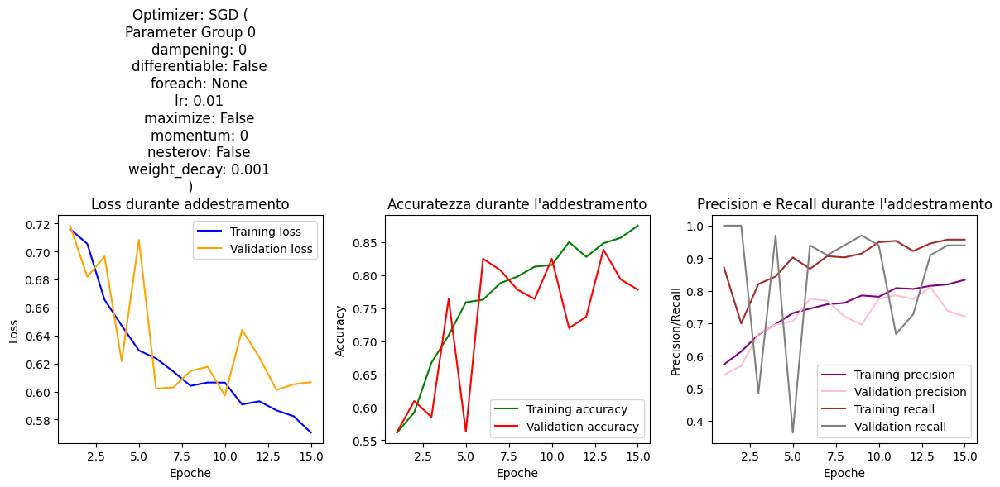

lr: 0.01, momentum: 0, wd: 0.01

Epoca n°0

Precision: 0.6369426751592356, Recall: 0.78125
89 114
56 200
Precision: 0.5714285714285714, Recall: 0.24242424242424243
22 6
25 8

Epoca n°1

Precision: 0.6677316293929713, Recall: 0.81640625
99 104
47 209
Precision: 0.6764705882352942, Recall: 0.696969696969697
17 11
10 23

Epoca n°2

Precision: 0.6755952380952381, Recall: 0.88671875
94 109
29 227
Precision: 0.6956521739130435, Recall: 0.9696969696969697
14 14
1 32

Epoca n°3

Precision: 0.7147335423197492, Recall: 0.890625
112 91
28 228
Precision: 0.6888888888888889, Recall: 0.9393939393939394
14 14
2 31

Epoca n°4

Precision: 0.7304075235109718, Recall: 0.91015625
117 86
23 233
Precision: 0.6896551724137931, Recall: 0.6060606060606061
19 9
13 20

Epoca n°5

Precision: 0.73, Recall: 0.85546875
122 81
37 219
Precision: 0.6888888888888889, Recall: 0.9393939393939394
14 14
2 31

Epoca n°6

Precision: 0.7492163009404389, Recall: 0.93359375
123 80
17 239
Precision: 0.6808510638297872, Recall: 0.

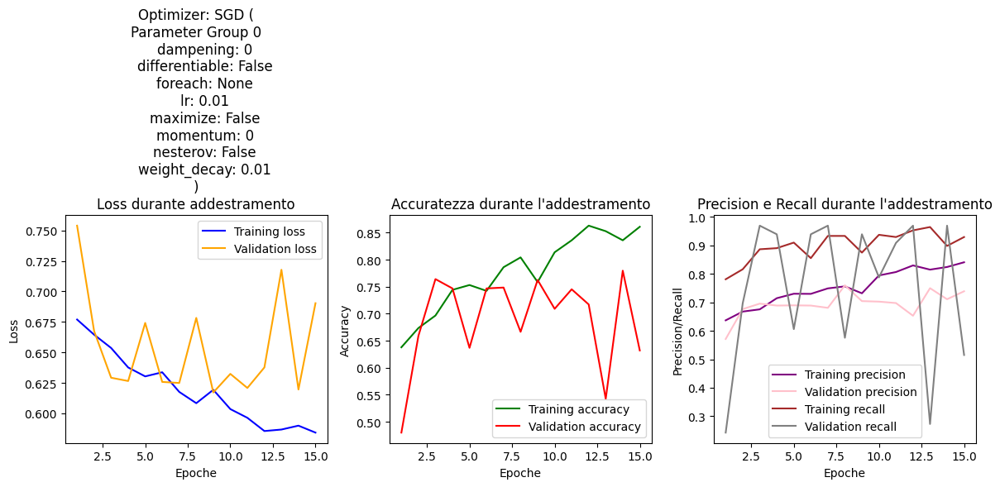

lr: 0.001, momentum: 0, wd: 0.01

Epoca n°0

Precision: 0.5927835051546392, Recall: 0.8984375
45 158
26 230
Precision: 0.675, Recall: 0.8181818181818182
15 13
6 27

Epoca n°1

Precision: 0.6616314199395771, Recall: 0.85546875
91 112
37 219
Precision: 0.6829268292682927, Recall: 0.8484848484848485
15 13
5 28

Epoca n°2

Precision: 0.6861538461538461, Recall: 0.87109375
101 102
33 223
Precision: 0.6744186046511628, Recall: 0.8787878787878788
14 14
4 29

Epoca n°3

Precision: 0.6888217522658611, Recall: 0.890625
100 103
28 228
Precision: 0.7, Recall: 0.8484848484848485
16 12
5 28

Epoca n°4

Precision: 0.6956521739130435, Recall: 0.875
105 98
32 224
Precision: 0.7, Recall: 0.8484848484848485
16 12
5 28

Epoca n°5

Precision: 0.7098765432098766, Recall: 0.8984375
109 94
26 230
Precision: 0.6976744186046512, Recall: 0.9090909090909091
15 13
3 30

Epoca n°6

Precision: 0.7230769230769231, Recall: 0.91796875
113 90
21 235
Precision: 0.7045454545454546, Recall: 0.9393939393939394
15 13
2 31

E

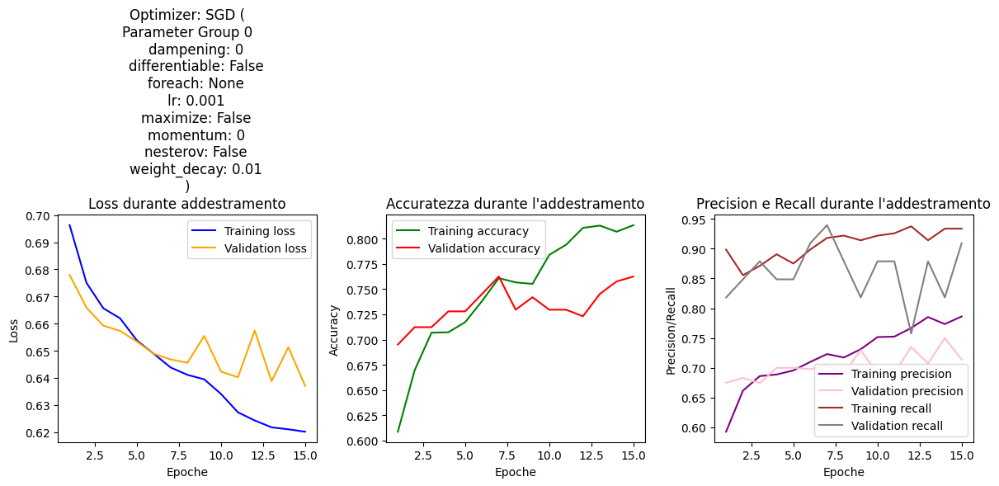

lr: 0.001, momentum: 0.9, wd: 0.001

Epoca n°0

Precision: 0.6324786324786325, Recall: 0.8671875
74 129
34 222
Precision: 0.6521739130434783, Recall: 0.9090909090909091
12 16
3 30

Epoca n°1

Precision: 0.691358024691358, Recall: 0.875
103 100
32 224
Precision: 0.6888888888888889, Recall: 0.9393939393939394
14 14
2 31

Epoca n°2

Precision: 0.6956521739130435, Recall: 0.875
105 98
32 224
Precision: 0.6888888888888889, Recall: 0.9393939393939394
14 14
2 31

Epoca n°3

Precision: 0.7258566978193146, Recall: 0.91015625
115 88
23 233
Precision: 0.6857142857142857, Recall: 0.7272727272727273
17 11
9 24

Epoca n°4

Precision: 0.7066246056782335, Recall: 0.875
110 93
32 224
Precision: 0.75, Recall: 0.7272727272727273
20 8
9 24

Epoca n°5

Precision: 0.7346278317152104, Recall: 0.88671875
121 82
29 227
Precision: 0.775, Recall: 0.9393939393939394
19 9
2 31

Epoca n°6

Precision: 0.7672131147540984, Recall: 0.9140625
132 71
22 234
Precision: 0.6739130434782609, Recall: 0.9393939393939394
13 15


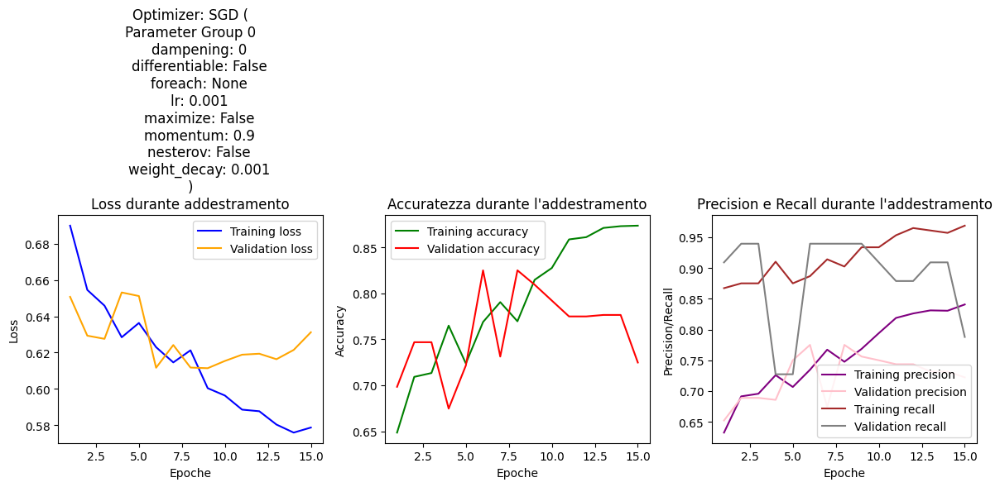

lr: 0.001, momentum: 0.95, wd: 0.0

Epoca n°0

Precision: 0.5745721271393643, Recall: 0.91796875
29 174
21 235
Precision: 0.6216216216216216, Recall: 0.696969696969697
14 14
10 23

Epoca n°1

Precision: 0.6677018633540373, Recall: 0.83984375
96 107
41 215
Precision: 0.6944444444444444, Recall: 0.7575757575757576
17 11
8 25

Epoca n°2

Precision: 0.7006172839506173, Recall: 0.88671875
106 97
29 227
Precision: 0.7894736842105263, Recall: 0.9090909090909091
20 8
3 30

Epoca n°3

Precision: 0.7360248447204969, Recall: 0.92578125
118 85
19 237
Precision: 0.7948717948717948, Recall: 0.9393939393939394
20 8
2 31

Epoca n°4

Precision: 0.7721088435374149, Recall: 0.88671875
136 67
29 227
Precision: 0.6666666666666666, Recall: 0.9696969696969697
12 16
1 32

Epoca n°5

Precision: 0.7766323024054983, Recall: 0.8828125
138 65
30 226
Precision: 0.6956521739130435, Recall: 0.9696969696969697
14 14
1 32

Epoca n°6

Precision: 0.79, Recall: 0.92578125
140 63
19 237
Precision: 0.7631578947368421, Recal

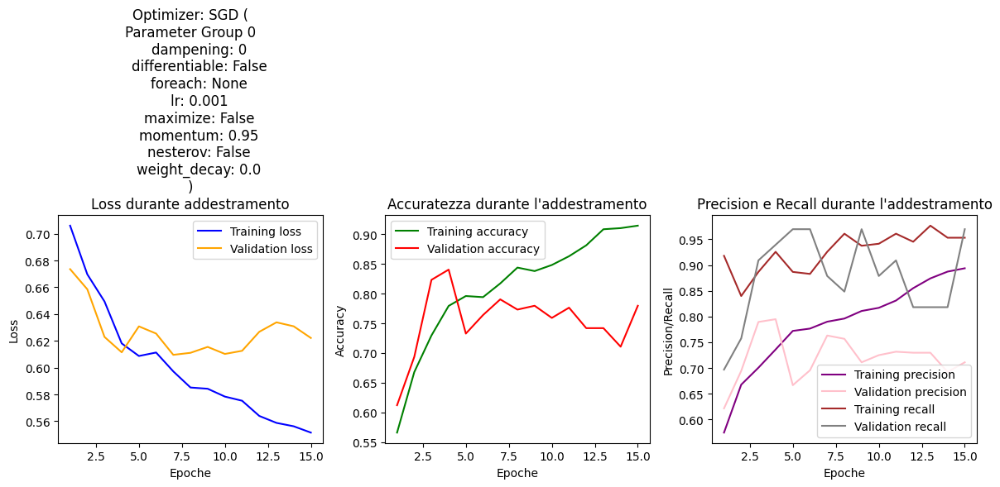

lr: 0.001, momentum: 0.99, wd: 0.01

Epoca n°0

Precision: 0.6302250803858521, Recall: 0.765625
88 115
60 196
Precision: 0.6458333333333334, Recall: 0.9393939393939394
11 17
2 31

Epoca n°1

Precision: 0.6781609195402298, Recall: 0.921875
91 112
20 236
Precision: 0.6944444444444444, Recall: 0.7575757575757576
17 11
8 25

Epoca n°2

Precision: 0.7051282051282052, Recall: 0.859375
111 92
36 220
Precision: 0.6666666666666666, Recall: 0.9696969696969697
12 16
1 32

Epoca n°3

Precision: 0.7041420118343196, Recall: 0.9296875
103 100
18 238
Precision: 0.7045454545454546, Recall: 0.9393939393939394
15 13
2 31

Epoca n°4

Precision: 0.6816901408450704, Recall: 0.9453125
90 113
14 242
Precision: 0.6666666666666666, Recall: 0.9696969696969697
12 16
1 32

Epoca n°5

Precision: 0.7102803738317757, Recall: 0.890625
110 93
28 228
Precision: 0.71875, Recall: 0.696969696969697
19 9
10 23

Epoca n°6

Precision: 0.7407407407407407, Recall: 0.703125
140 63
76 180
Precision: 0.7111111111111111, Recall: 0.

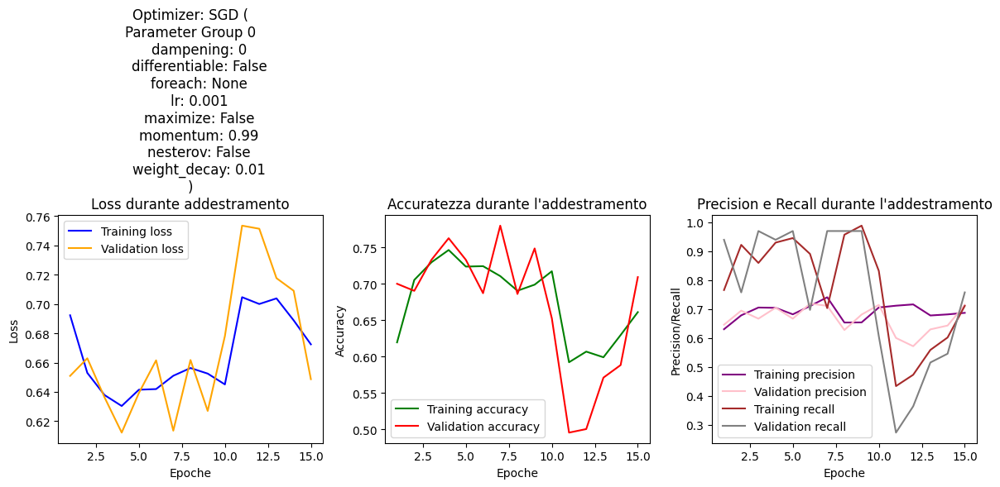

{'lr': 0.01, 'momentum': 0, 'weight_decay': 0.001, 'scale': None, 'val_loss': 0.6066522300243378, 'val_acc': 0.7780172413793103}


In [ ]:
TRAIN_LIMIT = 800
NUM_EPOCHS = 15

SAVE_MODELS = False

criterion = nn.BCEWithLogitsLoss()

params15 = [
    [0.01, 0, 0.001],
    [0.01, 0, 0.01],
    [0.001, 0, 0.01],
    [0.001, 0.9, 0.001],
    [0.001, 0.95, 0.0],
    [0.001, 0.99, 0.01]
]

params = [
    [0.1, 0, 0.0],
    [0.01, 0, 0.0],
    [0.01, 0, 0.01],
    [0.001, 0, 0.0],
    [0.001, 0, 0.001],
    [0.001, 0, 0.01],
    [0.001, 0.9, 0.001],
    [0.001, 0.95, 0.0],
    [0.001, 0.95, 0.001],
    [0.001, 0.99, 0.0]
]

best_params = {
    "lr" : 0,
    "momentum" : 0,
    "weight_decay" : 0,
    "scale" : 0,
    "val_loss" : 10,
    "val_acc" : 0
}

train_losses_ = []
val_losses_ = []
train_accs_ = []
val_accs_ = []

params = params15


for i in range(len(params)):

    lr = params[i][0]
    momentum = params[i][1]
    weight_decay = params[i][2]

    print(f"lr: {lr}, momentum: {momentum}, wd: {weight_decay}")

    torch.cuda.empty_cache()

    model = LeNet(num_classes=2).to(DEVICE)
    optimizer = optim.SGD(model.parameters(), lr=lr, momentum=momentum, weight_decay=weight_decay)

    train_losses, val_losses, train_accs, val_accs = train_model(
                train_loader,
                val_loader,
                model,
                optimizer,
                criterion,
                NUM_EPOCHS,
                MODELS_DIR,
                DEVICE,
                SAVE_MODELS
            )


    train_losses_.append(train_losses[-1])
    val_losses_.append(val_losses[-1])
    train_accs_.append(train_accs[-1])
    val_accs_.append(val_accs[-1])

    if (val_losses[-1] <= best_params["val_loss"] and val_accs[-1] >= best_params["val_acc"]):
        best_params["lr"] = lr
        best_params["momentum"] = momentum
        best_params["weight_decay"] = weight_decay
        best_params["scale"] = None   # scale
        best_params["val_loss"] = val_losses[-1]
        best_params["val_acc"] = val_accs[-1]

print(best_params)

lr: 0.001, momentum: 0, wd: 0.0

Epoca n°0

Precision: 0.6086956521739131, Recall: 0.4921875
122 81
130 126
Precision: 0.6363636363636364, Recall: 0.8484848484848485
12 16
5 28

Epoca n°1

Precision: 0.6419354838709678, Recall: 0.77734375
92 111
57 199
Precision: 0.7027027027027027, Recall: 0.7878787878787878
17 11
7 26

Epoca n°2

Precision: 0.6775244299674267, Recall: 0.8125
104 99
48 208
Precision: 0.7027027027027027, Recall: 0.7878787878787878
17 11
7 26

Epoca n°3

Precision: 0.6646153846153846, Recall: 0.84375
94 109
40 216
Precision: 0.696969696969697, Recall: 0.696969696969697
18 10
10 23

Epoca n°4

Precision: 0.694078947368421, Recall: 0.82421875
110 93
45 211
Precision: 0.6976744186046512, Recall: 0.9090909090909091
15 13
3 30

Epoca n°5

Precision: 0.6975308641975309, Recall: 0.8828125
105 98
30 226
Precision: 0.6976744186046512, Recall: 0.9090909090909091
15 13
3 30

Epoca n°6

Precision: 0.7042682926829268, Recall: 0.90234375
106 97
25 231
Precision: 0.725, Recall: 0.8787

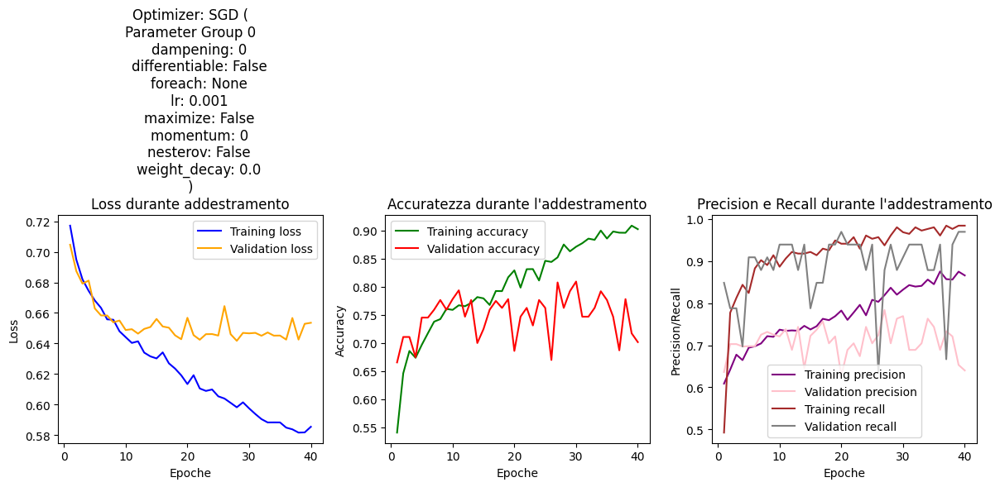

lr: 0.001, momentum: 0, wd: 0.001

Epoca n°0

Precision: 0.6497005988023952, Recall: 0.84765625
86 117
39 217
Precision: 0.7105263157894737, Recall: 0.8181818181818182
17 11
6 27

Epoca n°1

Precision: 0.6776119402985075, Recall: 0.88671875
95 108
29 227
Precision: 0.6956521739130435, Recall: 0.9696969696969697
14 14
1 32

Epoca n°2

Precision: 0.691358024691358, Recall: 0.875
103 100
32 224
Precision: 0.6808510638297872, Recall: 0.9696969696969697
13 15
1 32

Epoca n°3

Precision: 0.6923076923076923, Recall: 0.9140625
99 104
22 234
Precision: 0.725, Recall: 0.8787878787878788
17 11
4 29

Epoca n°4

Precision: 0.7067901234567902, Recall: 0.89453125
108 95
27 229
Precision: 0.6888888888888889, Recall: 0.9393939393939394
14 14
2 31

Epoca n°5

Precision: 0.7186544342507645, Recall: 0.91796875
111 92
21 235
Precision: 0.6808510638297872, Recall: 0.9696969696969697
13 15
1 32

Epoca n°6

Precision: 0.7121212121212122, Recall: 0.91796875
108 95
21 235
Precision: 0.6808510638297872, Recall: 

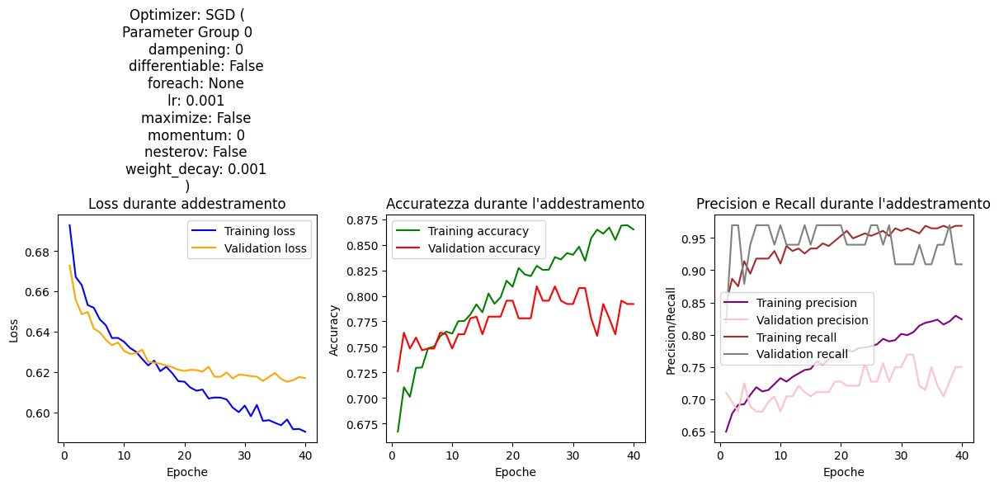

lr: 0.001, momentum: 0, wd: 0.01

Epoca n°0

Precision: 0.5678160919540229, Recall: 0.96484375
15 188
9 247
Precision: 0.6530612244897959, Recall: 0.9696969696969697
11 17
1 32

Epoca n°1

Precision: 0.6311475409836066, Recall: 0.90234375
68 135
25 231
Precision: 0.6976744186046512, Recall: 0.9090909090909091
15 13
3 30

Epoca n°2

Precision: 0.6807228915662651, Recall: 0.8828125
97 106
30 226
Precision: 0.6756756756756757, Recall: 0.7575757575757576
16 12
8 25

Epoca n°3

Precision: 0.6976744186046512, Recall: 0.8203125
112 91
46 210
Precision: 0.6976744186046512, Recall: 0.9090909090909091
15 13
3 30

Epoca n°4

Precision: 0.7025316455696202, Recall: 0.8671875
109 94
34 222
Precision: 0.6976744186046512, Recall: 0.9090909090909091
15 13
3 30

Epoca n°5

Precision: 0.7188498402555911, Recall: 0.87890625
115 88
31 225
Precision: 0.7027027027027027, Recall: 0.7878787878787878
17 11
7 26

Epoca n°6

Precision: 0.7328767123287672, Recall: 0.8359375
125 78
42 214
Precision: 0.7111111111111

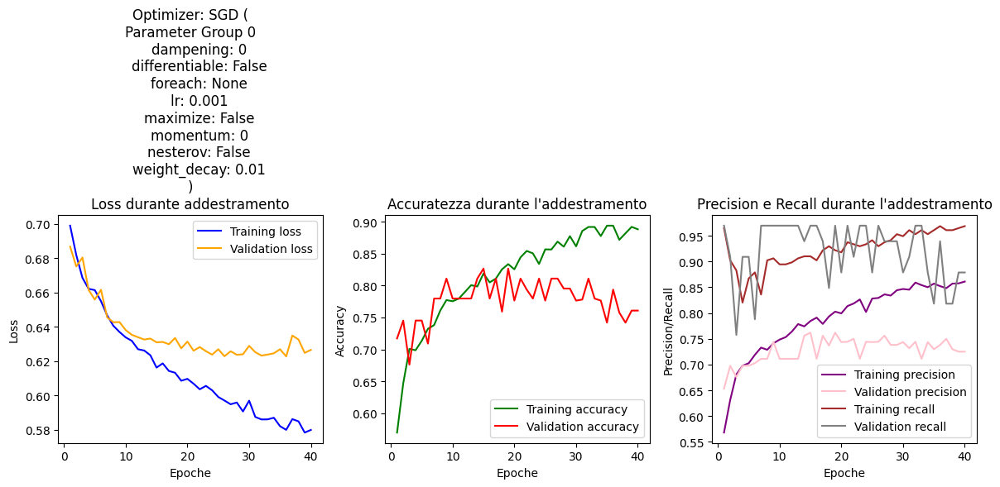

lr: 0.001, momentum: 0.9, wd: 0.001

Epoca n°0

Precision: 0.617816091954023, Recall: 0.83984375
70 133
41 215
Precision: 0.6888888888888889, Recall: 0.9393939393939394
14 14
2 31

Epoca n°1

Precision: 0.6845238095238095, Recall: 0.8984375
97 106
26 230
Precision: 0.7567567567567568, Recall: 0.8484848484848485
19 9
5 28

Epoca n°2

Precision: 0.7125382262996942, Recall: 0.91015625
109 94
23 233
Precision: 0.7560975609756098, Recall: 0.9393939393939394
18 10
2 31

Epoca n°3

Precision: 0.7356687898089171, Recall: 0.90234375
120 83
25 231
Precision: 0.7111111111111111, Recall: 0.9696969696969697
15 13
1 32

Epoca n°4

Precision: 0.7602523659305994, Recall: 0.94140625
127 76
15 241
Precision: 0.7619047619047619, Recall: 0.9696969696969697
18 10
1 32

Epoca n°5

Precision: 0.7738853503184714, Recall: 0.94921875
132 71
13 243
Precision: 0.7441860465116279, Recall: 0.9696969696969697
17 11
1 32

Epoca n°6

Precision: 0.7866242038216561, Recall: 0.96484375
136 67
9 247
Precision: 0.744186046

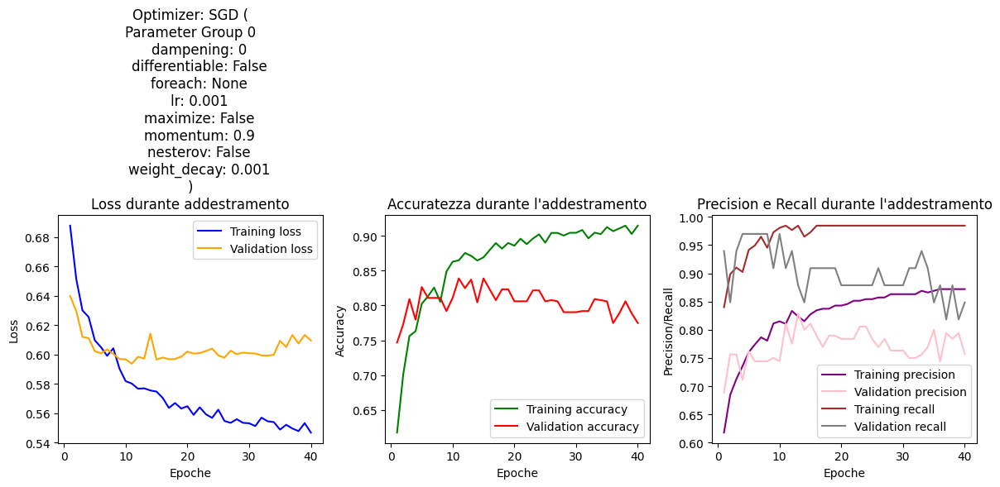

lr: 0.001, momentum: 0.95, wd: 0.0

Epoca n°0

Precision: 0.564625850340136, Recall: 0.97265625
11 192
7 249
Precision: 0.6578947368421053, Recall: 0.7575757575757576
15 13
8 25

Epoca n°1

Precision: 0.6678966789667896, Recall: 0.70703125
113 90
75 181
Precision: 0.6818181818181818, Recall: 0.9090909090909091
14 14
3 30

Epoca n°2

Precision: 0.676829268292683, Recall: 0.8671875
97 106
34 222
Precision: 0.75, Recall: 0.7272727272727273
20 8
9 24

Epoca n°3

Precision: 0.7211538461538461, Recall: 0.87890625
116 87
31 225
Precision: 0.7380952380952381, Recall: 0.9393939393939394
17 11
2 31

Epoca n°4

Precision: 0.7442622950819672, Recall: 0.88671875
125 78
29 227
Precision: 0.7045454545454546, Recall: 0.9393939393939394
15 13
2 31

Epoca n°5

Precision: 0.7643097643097643, Recall: 0.88671875
133 70
29 227
Precision: 0.7435897435897436, Recall: 0.8787878787878788
18 10
4 29

Epoca n°6

Precision: 0.7913907284768212, Recall: 0.93359375
140 63
17 239
Precision: 0.7631578947368421, Recall:

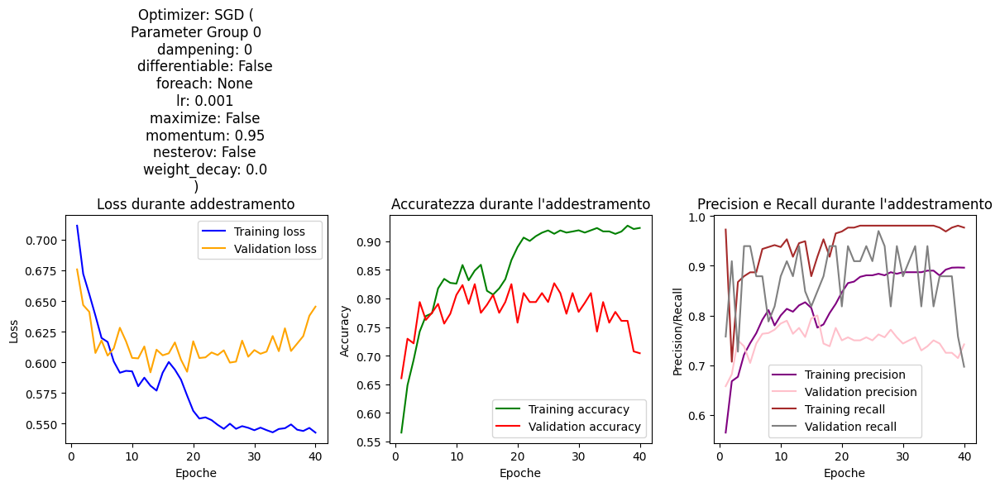

lr: 0.001, momentum: 0.95, wd: 0.001

Epoca n°0

Precision: 0.5819672131147541, Recall: 0.83203125
50 153
43 213
Precision: 0.6764705882352942, Recall: 0.696969696969697
17 11
10 23

Epoca n°1

Precision: 0.637883008356546, Recall: 0.89453125
73 130
27 229
Precision: 0.7105263157894737, Recall: 0.8181818181818182
17 11
6 27

Epoca n°2

Precision: 0.7120622568093385, Recall: 0.71484375
129 74
73 183
Precision: 0.6956521739130435, Recall: 0.9696969696969697
14 14
1 32

Epoca n°3

Precision: 0.6613756613756614, Recall: 0.9765625
75 128
6 250
Precision: 0.6956521739130435, Recall: 0.9696969696969697
14 14
1 32

Epoca n°4

Precision: 0.7170418006430869, Recall: 0.87109375
115 88
33 223
Precision: 0.7272727272727273, Recall: 0.9696969696969697
16 12
1 32

Epoca n°5

Precision: 0.740506329113924, Recall: 0.9140625
121 82
22 234
Precision: 0.7619047619047619, Recall: 0.9696969696969697
18 10
1 32

Epoca n°6

Precision: 0.7715231788079471, Recall: 0.91015625
134 69
23 233
Precision: 0.761904761

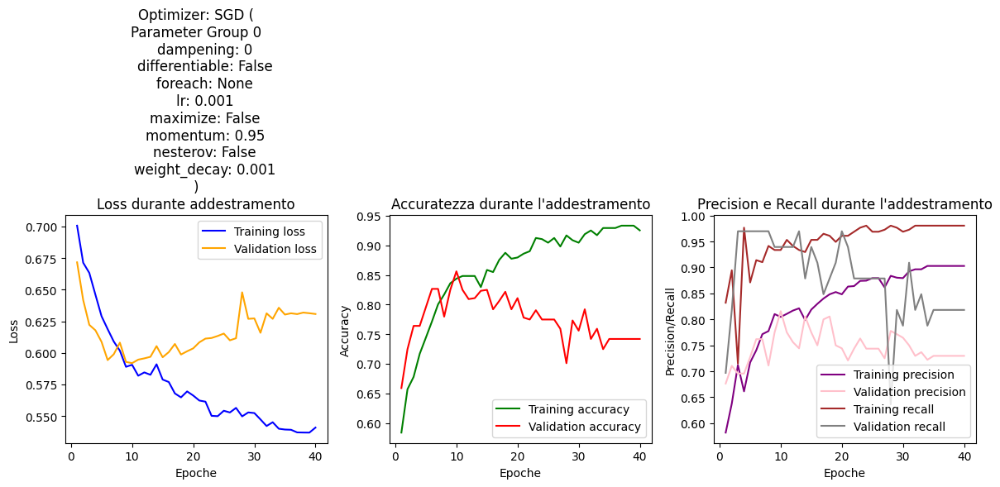

lr: 0.001, momentum: 0.99, wd: 0.0

Epoca n°0

Precision: 0.6139817629179332, Recall: 0.7890625
76 127
54 202
Precision: 0.6829268292682927, Recall: 0.8484848484848485
15 13
5 28

Epoca n°1

Precision: 0.6765578635014837, Recall: 0.890625
94 109
28 228
Precision: 0.7222222222222222, Recall: 0.7878787878787878
18 10
7 26

Epoca n°2

Precision: 0.7247386759581882, Recall: 0.8125
124 79
48 208
Precision: 0.64, Recall: 0.9696969696969697
10 18
1 32

Epoca n°3

Precision: 0.7605633802816901, Recall: 0.84375
135 68
40 216
Precision: 0.7441860465116279, Recall: 0.9696969696969697
17 11
1 32

Epoca n°4

Precision: 0.7243401759530792, Recall: 0.96484375
109 94
9 247
Precision: 0.7441860465116279, Recall: 0.9696969696969697
17 11
1 32

Epoca n°5

Precision: 0.7583892617449665, Recall: 0.8828125
131 72
30 226
Precision: 0.8, Recall: 0.9696969696969697
20 8
1 32

Epoca n°6

Precision: 0.7398119122257053, Recall: 0.921875
120 83
20 236
Precision: 0.7435897435897436, Recall: 0.8787878787878788
18 10

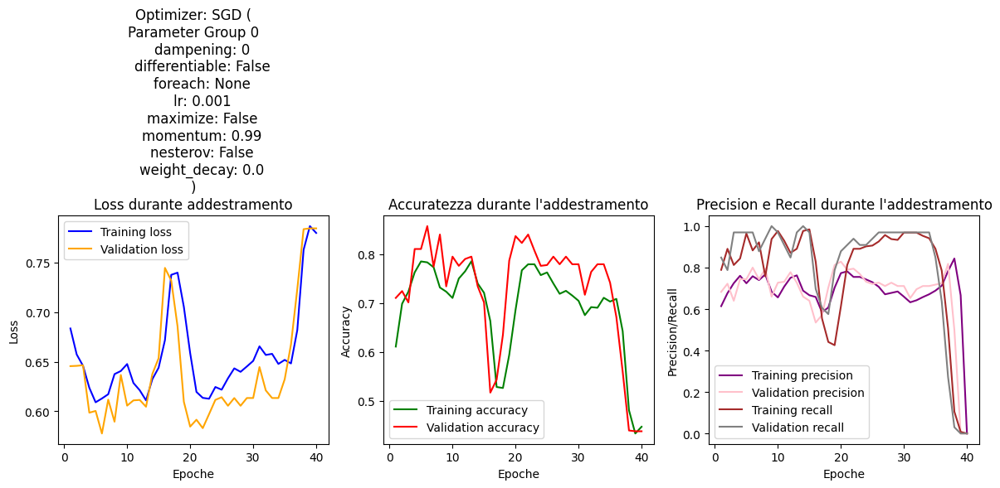

{'lr': 0.001, 'momentum': 0, 'weight_decay': 0.001, 'scale': None, 'val_loss': 0.6169353127479553, 'val_acc': 0.7920258620689655}


In [ ]:
import torch
import torch.optim as optim

NUM_EPOCHS = 40


params = [
    [0.001, 0, 0.0],
    [0.001, 0, 0.001],
    [0.001, 0, 0.01],
    [0.001, 0.9, 0.001],
    [0.001, 0.95, 0.0],
    [0.001, 0.95, 0.001],
    [0.001, 0.99, 0.0]
]


best_params = {
    "lr" : 0,
    "momentum" : 0,
    "weight_decay" : 0,
    "scale" : 0,
    "val_loss" : 10,
    "val_acc" : 0
}

train_losses_ = []
val_losses_ = []
train_accs_ = []
val_accs_ = []


for i in range(len(params)):

    lr = params[i][0]
    momentum = params[i][1]
    weight_decay = params[i][2]

    print(f"lr: {lr}, momentum: {momentum}, wd: {weight_decay}")

    torch.cuda.empty_cache()

    model = LeNet(num_classes=2).to(DEVICE)
    optimizer = optim.SGD(model.parameters(), lr=lr, momentum=momentum, weight_decay=weight_decay)

    train_losses, val_losses, train_accs, val_accs = train_model(
                train_loader,
                val_loader,
                model,
                optimizer,
                criterion,
                NUM_EPOCHS,
                MODELS_DIR,
                DEVICE,
                SAVE_MODELS
            )


    train_losses_.append(train_losses[-1])
    val_losses_.append(val_losses[-1])
    train_accs_.append(train_accs[-1])
    val_accs_.append(val_accs[-1])

    if (val_losses[-1] <= best_params["val_loss"] and val_accs[-1] >= best_params["val_acc"]):
        best_params["lr"] = lr
        best_params["momentum"] = momentum
        best_params["weight_decay"] = weight_decay
        best_params["scale"] = None   # scale
        best_params["val_loss"] = val_losses[-1]
        best_params["val_acc"] = val_accs[-1]

print(best_params)

lr: 0.001, momentum: 0, wd: 0.001

Epoca n°0

Precision: 0.5851851851851851, Recall: 0.92578125
35 168
19 237
Precision: 0.6666666666666666, Recall: 0.7878787878787878
15 13
7 26

Epoca n°1

Precision: 0.6595092024539877, Recall: 0.83984375
92 111
41 215
Precision: 0.6595744680851063, Recall: 0.9393939393939394
12 16
2 31

Epoca n°2

Precision: 0.6676470588235294, Recall: 0.88671875
90 113
29 227
Precision: 0.6739130434782609, Recall: 0.9393939393939394
13 15
2 31

Epoca n°3

Precision: 0.6787878787878788, Recall: 0.875
97 106
32 224
Precision: 0.7105263157894737, Recall: 0.8181818181818182
17 11
6 27

Epoca n°4

Precision: 0.7044025157232704, Recall: 0.875
109 94
32 224
Precision: 0.6744186046511628, Recall: 0.8787878787878788
14 14
4 29

Epoca n°5

Precision: 0.7069486404833837, Recall: 0.9140625
106 97
22 234
Precision: 0.6904761904761905, Recall: 0.8787878787878788
15 13
4 29

Epoca n°6

Precision: 0.7078313253012049, Recall: 0.91796875
106 97
21 235
Precision: 0.6904761904761905, 

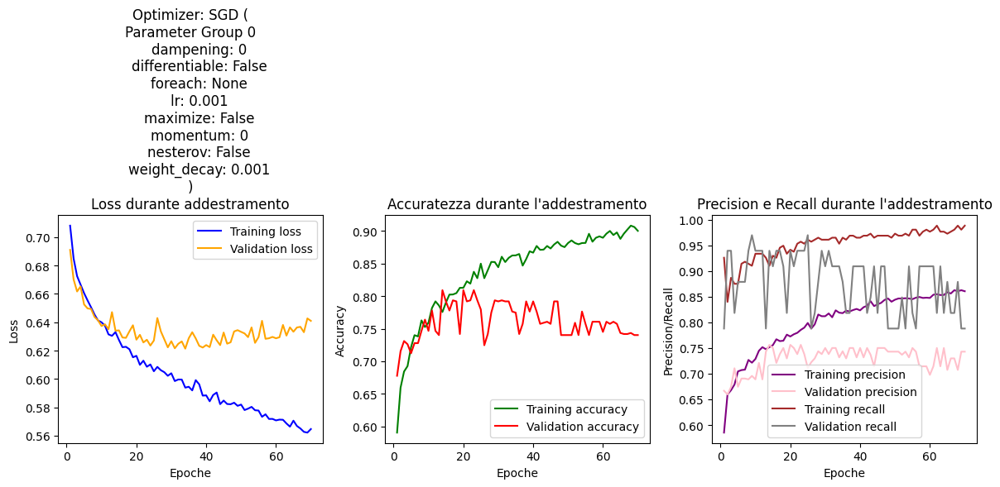

lr: 0.001, momentum: 0.9, wd: 0.001

Epoca n°0

Precision: 0.6862068965517242, Recall: 0.77734375
112 91
57 199
Precision: 0.6976744186046512, Recall: 0.9090909090909091
15 13
3 30

Epoca n°1

Precision: 0.6884272997032641, Recall: 0.90625
98 105
24 232
Precision: 0.6808510638297872, Recall: 0.9696969696969697
13 15
1 32

Epoca n°2

Precision: 0.7, Recall: 0.8203125
113 90
46 210
Precision: 0.6739130434782609, Recall: 0.9393939393939394
13 15
2 31

Epoca n°3

Precision: 0.6927536231884058, Recall: 0.93359375
97 106
17 239
Precision: 0.6888888888888889, Recall: 0.9393939393939394
14 14
2 31

Epoca n°4

Precision: 0.7376543209876543, Recall: 0.93359375
118 85
17 239
Precision: 0.7045454545454546, Recall: 0.9393939393939394
15 13
2 31

Epoca n°5

Precision: 0.7626582278481012, Recall: 0.94140625
128 75
15 241
Precision: 0.7894736842105263, Recall: 0.9090909090909091
20 8
3 30

Epoca n°6

Precision: 0.7795527156549521, Recall: 0.953125
134 69
12 244
Precision: 0.775, Recall: 0.939393939393

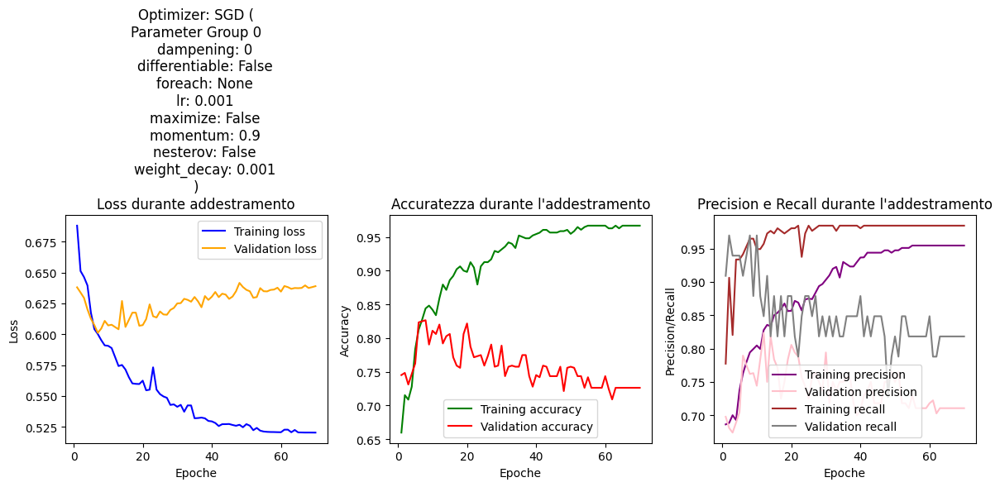

{'lr': 0.001, 'momentum': 0, 'weight_decay': 0.001, 'scale': None, 'val_loss': 0.6409915387630463, 'val_acc': 0.740301724137931}


In [ ]:
import torch
import torch.optim as optim

NUM_EPOCHS = 70

params15 = [
    [0.001, 0, 0.001],
    [0.001, 0.9, 0.001],
]

params = [
    [0.001, 0, 0.0],
    [0.001, 0, 0.001],
    [0.001, 0, 0.01],
    [0.001, 0.95, 0.001],
]

params = params15

best_params = {
    "lr" : 0,
    "momentum" : 0,
    "weight_decay" : 0,
    "scale" : 0,
    "val_loss" : 10,
    "val_acc" : 0
}

train_losses_ = []
val_losses_ = []
train_accs_ = []
val_accs_ = []


for i in range(len(params)):

    lr = params[i][0]
    momentum = params[i][1]
    weight_decay = params[i][2]

    print(f"lr: {lr}, momentum: {momentum}, wd: {weight_decay}")

    torch.cuda.empty_cache()

    model = LeNet(num_classes=2).to(DEVICE)
    optimizer = optim.SGD(model.parameters(), lr=lr, momentum=momentum, weight_decay=weight_decay)

    train_losses, val_losses, train_accs, val_accs = train_model(
                train_loader,
                val_loader,
                model,
                optimizer,
                criterion,
                NUM_EPOCHS,
                MODELS_DIR,
                DEVICE,
                SAVE_MODELS
            )


    train_losses_.append(train_losses[-1])
    val_losses_.append(val_losses[-1])
    train_accs_.append(train_accs[-1])
    val_accs_.append(val_accs[-1])

    if (val_losses[-1] <= best_params["val_loss"] and val_accs[-1] >= best_params["val_acc"]):
        best_params["lr"] = lr
        best_params["momentum"] = momentum
        best_params["weight_decay"] = weight_decay
        best_params["scale"] = None   # scale
        best_params["val_loss"] = val_losses[-1]
        best_params["val_acc"] = val_accs[-1]

print(best_params)

lr: 0.001, momentum: 0, wd: 0.001

Epoca n°0

Precision: 0.61003861003861, Recall: 0.7117117117117117
204 202
128 316
Precision: 0.6027397260273972, Recall: 0.8
28 29
11 44

Epoca n°1

Precision: 0.6726296958855098, Recall: 0.8468468468468469
223 183
68 376
Precision: 0.6027397260273972, Recall: 0.8
28 29
11 44

Epoca n°2

Precision: 0.677536231884058, Recall: 0.8423423423423423
228 178
70 374
Precision: 0.6111111111111112, Recall: 0.8
29 28
11 44

Epoca n°3

Precision: 0.6923076923076923, Recall: 0.8716216216216216
234 172
57 387
Precision: 0.6285714285714286, Recall: 0.8
31 26
11 44

Epoca n°4

Precision: 0.6998223801065719, Recall: 0.8873873873873874
237 169
50 394
Precision: 0.6376811594202898, Recall: 0.8
32 25
11 44

Epoca n°5

Precision: 0.710091743119266, Recall: 0.8716216216216216
248 158
57 387
Precision: 0.647887323943662, Recall: 0.8363636363636363
32 25
9 46

Epoca n°6

Precision: 0.7158469945355191, Recall: 0.8851351351351351
250 156
51 393
Precision: 0.6438356164383562, 

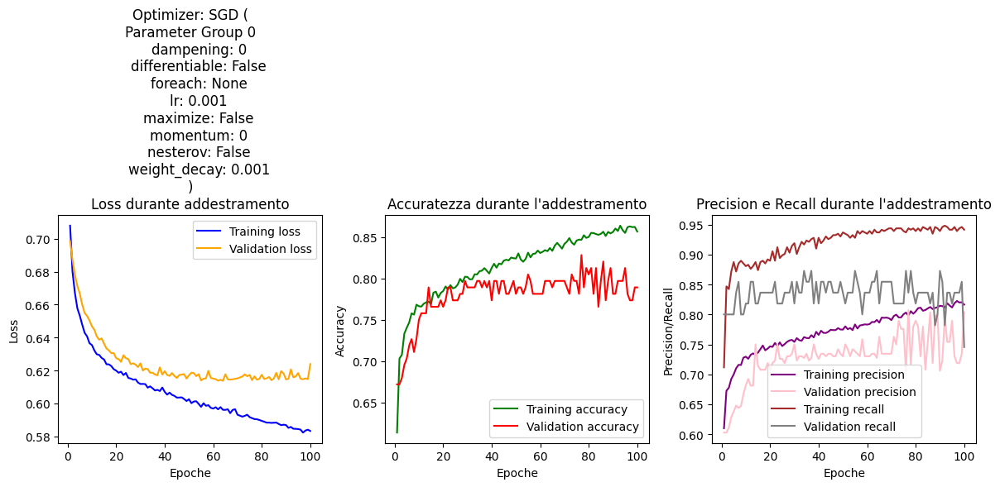

lr: 0.001, momentum: 0, wd: 0.01

Epoca n°0

Precision: 0.6340640809443507, Recall: 0.8468468468468469
189 217
68 376
Precision: 0.5897435897435898, Recall: 0.8363636363636363
25 32
9 46

Epoca n°1

Precision: 0.6666666666666666, Recall: 0.8783783783783784
211 195
54 390
Precision: 0.6086956521739131, Recall: 0.7636363636363637
30 27
13 42

Epoca n°2

Precision: 0.6869409660107334, Recall: 0.8648648648648649
231 175
60 384
Precision: 0.6266666666666667, Recall: 0.8545454545454545
29 28
8 47

Epoca n°3

Precision: 0.688695652173913, Recall: 0.8918918918918919
227 179
48 396
Precision: 0.6323529411764706, Recall: 0.7818181818181819
32 25
12 43

Epoca n°4

Precision: 0.7111517367458866, Recall: 0.8761261261261262
248 158
55 389
Precision: 0.6323529411764706, Recall: 0.7818181818181819
32 25
12 43

Epoca n°5

Precision: 0.716390423572744, Recall: 0.8761261261261262
252 154
55 389
Precision: 0.6323529411764706, Recall: 0.7818181818181819
32 25
12 43

Epoca n°6

Precision: 0.7194899817850637

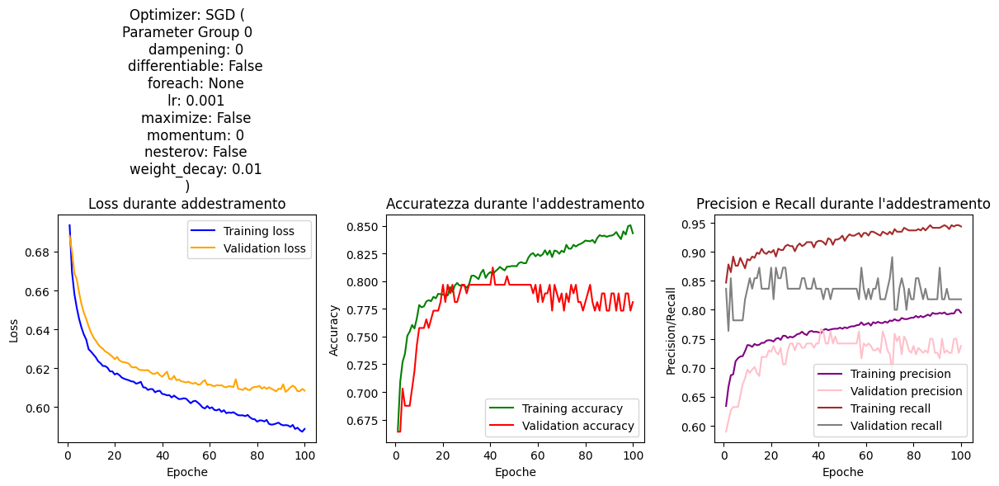

{'lr': 0.001, 'momentum': 0, 'weight_decay': 0.001, 'scale': None, 'val_loss': 0.6239029318094254, 'val_acc': 0.7890625}


In [ ]:
import torch
import torch.optim as optim

NUM_EPOCHS = 100

params = [
    [0.001, 0, 0.001],
    [0.001, 0, 0.01],
]


best_params = {
    "lr" : 0,
    "momentum" : 0,
    "weight_decay" : 0,
    "scale" : 0,
    "val_loss" : 10,
    "val_acc" : 0
}

train_losses_ = []
val_losses_ = []
train_accs_ = []
val_accs_ = []


for i in range(len(params)):

    lr = params[i][0]
    momentum = params[i][1]
    weight_decay = params[i][2]

    print(f"lr: {lr}, momentum: {momentum}, wd: {weight_decay}")

    torch.cuda.empty_cache()

    model = LeNet(num_classes=2).to(DEVICE)
    optimizer = optim.SGD(model.parameters(), lr=lr, momentum=momentum, weight_decay=weight_decay)

    train_losses, val_losses, train_accs, val_accs = train_model(
                train_loader,
                val_loader,
                model,
                optimizer,
                criterion,
                NUM_EPOCHS,
                MODELS_DIR,
                DEVICE,
                SAVE_MODELS
            )


    train_losses_.append(train_losses[-1])
    val_losses_.append(val_losses[-1])
    train_accs_.append(train_accs[-1])
    val_accs_.append(val_accs[-1])

    if (val_losses[-1] <= best_params["val_loss"] and val_accs[-1] >= best_params["val_acc"]):
        best_params["lr"] = lr
        best_params["momentum"] = momentum
        best_params["weight_decay"] = weight_decay
        best_params["scale"] = None   # scale
        best_params["val_loss"] = val_losses[-1]
        best_params["val_acc"] = val_accs[-1]

print(best_params)

#### Adam

lr: 1e-05, wd: 0

Epoca n°0

Precision: 0.6559714795008913, Recall: 0.8288288288288288
213 193
76 368
Precision: 0.5844155844155844, Recall: 0.8181818181818182
25 32
10 45

Epoca n°1

Precision: 0.7300380228136882, Recall: 0.8648648648648649
264 142
60 384
Precision: 0.6049382716049383, Recall: 0.8909090909090909
25 32
6 49

Epoca n°2

Precision: 0.762278978388998, Recall: 0.8738738738738738
285 121
56 388
Precision: 0.6567164179104478, Recall: 0.8
34 23
11 44

Epoca n°3

Precision: 0.7732793522267206, Recall: 0.8603603603603603
294 112
62 382
Precision: 0.6712328767123288, Recall: 0.8909090909090909
33 24
6 49

Epoca n°4

Precision: 0.7820267686424475, Recall: 0.9211711711711712
292 114
35 409
Precision: 0.6567164179104478, Recall: 0.8
34 23
11 44

Epoca n°5

Precision: 0.8104838709677419, Recall: 0.9054054054054054
312 94
42 402
Precision: 0.6666666666666666, Recall: 0.9454545454545454
31 26
3 52

Epoca n°6

Precision: 0.8030592734225621, Recall: 0.9459459459459459
303 103
24 420
Pre

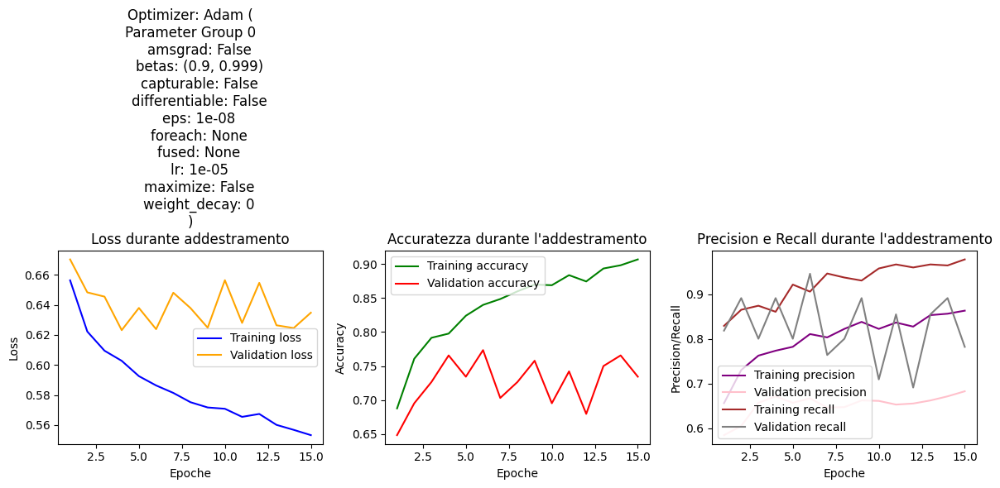

lr: 1e-06, wd: 0

Epoca n°0

Precision: 0.5935085007727975, Recall: 0.8648648648648649
143 263
60 384
Precision: 0.5769230769230769, Recall: 0.8181818181818182
24 33
10 45

Epoca n°1

Precision: 0.6864864864864865, Recall: 0.8581081081081081
232 174
63 381
Precision: 0.5822784810126582, Recall: 0.8363636363636363
24 33
9 46

Epoca n°2

Precision: 0.716636197440585, Recall: 0.8828828828828829
251 155
52 392
Precision: 0.5844155844155844, Recall: 0.8181818181818182
25 32
10 45

Epoca n°3

Precision: 0.7357798165137615, Recall: 0.9031531531531531
262 144
43 401
Precision: 0.5833333333333334, Recall: 0.7636363636363637
27 30
13 42

Epoca n°4

Precision: 0.7566539923954373, Recall: 0.8963963963963963
278 128
46 398
Precision: 0.6056338028169014, Recall: 0.7818181818181819
29 28
12 43

Epoca n°5

Precision: 0.7575757575757576, Recall: 0.9009009009009009
278 128
44 400
Precision: 0.6166666666666667, Recall: 0.6727272727272727
34 23
18 37

Epoca n°6

Precision: 0.7664092664092664, Recall: 0.89

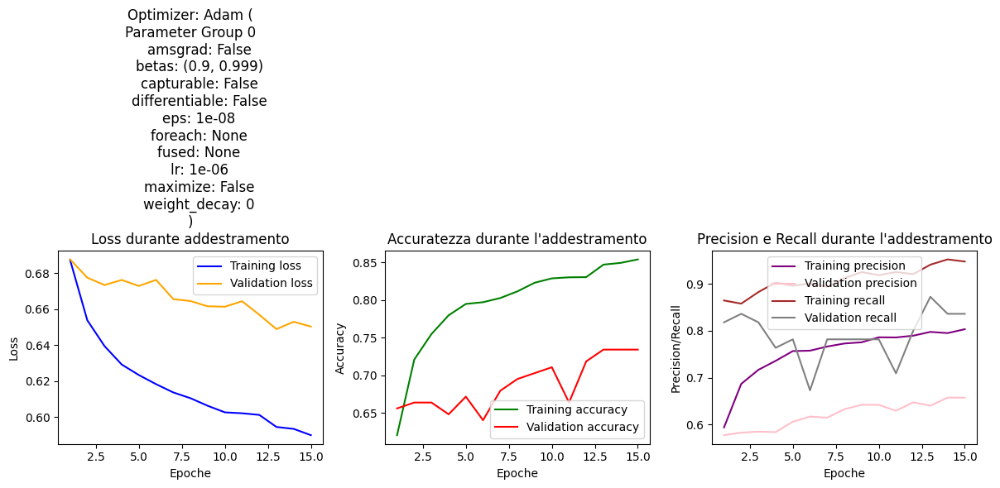

lr: 1e-07, wd: 0

Epoca n°0

Precision: 0.6532663316582915, Recall: 0.2927927927927928
337 69
314 130
Precision: 0.5569620253164557, Recall: 0.8
22 35
11 44

Epoca n°1

Precision: 0.6005706134094151, Recall: 0.9481981981981982
126 280
23 421
Precision: 0.5463917525773195, Recall: 0.9636363636363636
13 44
2 53

Epoca n°2

Precision: 0.59500693481276, Recall: 0.9662162162162162
114 292
15 429
Precision: 0.5416666666666666, Recall: 0.9454545454545454
13 44
3 52

Epoca n°3

Precision: 0.6097560975609756, Recall: 0.9572072072072072
134 272
19 425
Precision: 0.5531914893617021, Recall: 0.9454545454545454
15 42
3 52

Epoca n°4

Precision: 0.6300751879699248, Recall: 0.9436936936936937
160 246
25 419
Precision: 0.5604395604395604, Recall: 0.9272727272727272
17 40
4 51

Epoca n°5

Precision: 0.6387195121951219, Recall: 0.9436936936936937
169 237
25 419
Precision: 0.5604395604395604, Recall: 0.9272727272727272
17 40
4 51

Epoca n°6

Precision: 0.6603174603174603, Recall: 0.9369369369369369
192 2

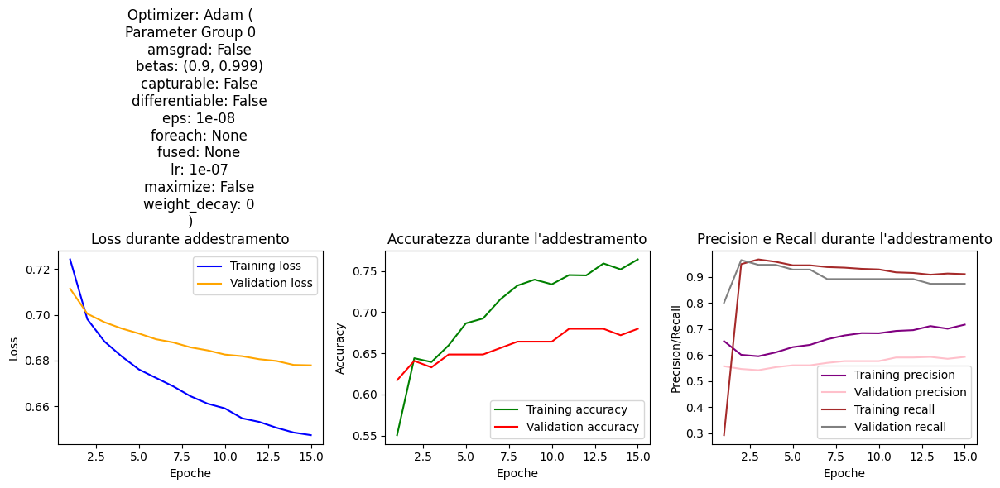

lr: 1e-08, wd: 0

Epoca n°0

Precision: 0.5427841634738186, Recall: 0.9572072072072072
48 358
19 425
Precision: 0.5242718446601942, Recall: 0.9818181818181818
8 49
1 54

Epoca n°1

Precision: 0.5437262357414449, Recall: 0.9662162162162162
46 360
15 429
Precision: 0.5196078431372549, Recall: 0.9636363636363636
8 49
2 53

Epoca n°2

Precision: 0.55198973042362, Recall: 0.9684684684684685
57 349
14 430
Precision: 0.5247524752475248, Recall: 0.9636363636363636
9 48
2 53

Epoca n°3

Precision: 0.5602094240837696, Recall: 0.963963963963964
70 336
16 428
Precision: 0.5306122448979592, Recall: 0.9454545454545454
11 46
3 52

Epoca n°4

Precision: 0.5739014647137151, Recall: 0.9707207207207207
86 320
13 431
Precision: 0.5408163265306123, Recall: 0.9636363636363636
12 45
2 53

Epoca n°5

Precision: 0.5795918367346938, Recall: 0.9594594594594594
97 309
18 426
Precision: 0.5473684210526316, Recall: 0.9454545454545454
14 43
3 52

Epoca n°6

Precision: 0.5949720670391061, Recall: 0.9594594594594594
1

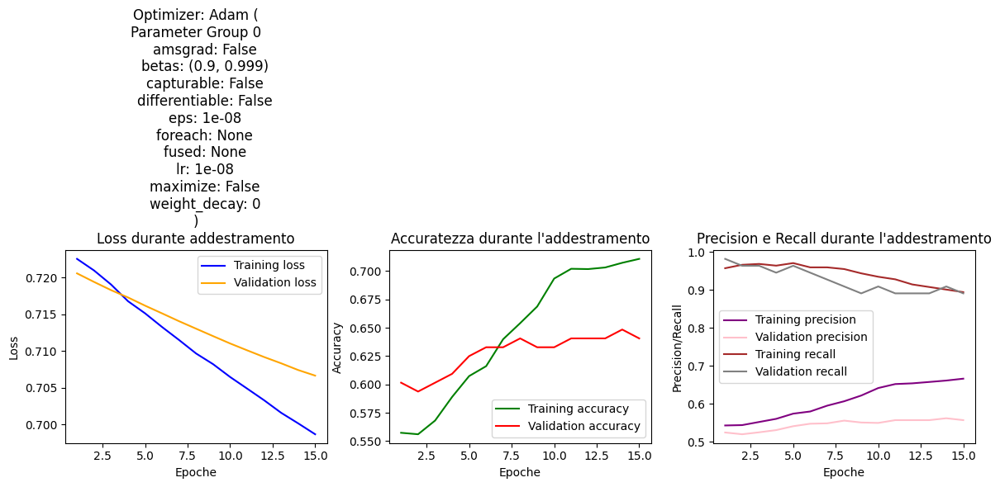

lr: 1e-09, wd: 0

Epoca n°0

Precision: 0.48811700182815354, Recall: 0.6013513513513513
126 280
177 267
Precision: 0.43661971830985913, Recall: 0.5636363636363636
17 40
24 31

Epoca n°1

Precision: 0.49097472924187724, Recall: 0.6126126126126126
124 282
172 272
Precision: 0.4383561643835616, Recall: 0.5818181818181818
16 41
23 32

Epoca n°2

Precision: 0.49552772808586765, Recall: 0.6238738738738738
124 282
167 277
Precision: 0.43243243243243246, Recall: 0.5818181818181818
15 42
23 32

Epoca n°3

Precision: 0.4964788732394366, Recall: 0.6351351351351351
120 286
162 282
Precision: 0.44, Recall: 0.6
15 42
22 33

Epoca n°4

Precision: 0.5, Recall: 0.6554054054054054
115 291
153 291
Precision: 0.4473684210526316, Recall: 0.6181818181818182
15 42
21 34

Epoca n°5

Precision: 0.5067796610169492, Recall: 0.6734234234234234
115 291
145 299
Precision: 0.4473684210526316, Recall: 0.6181818181818182
15 42
21 34

Epoca n°6

Precision: 0.509212730318258, Recall: 0.6846846846846847
113 293
140 304
P

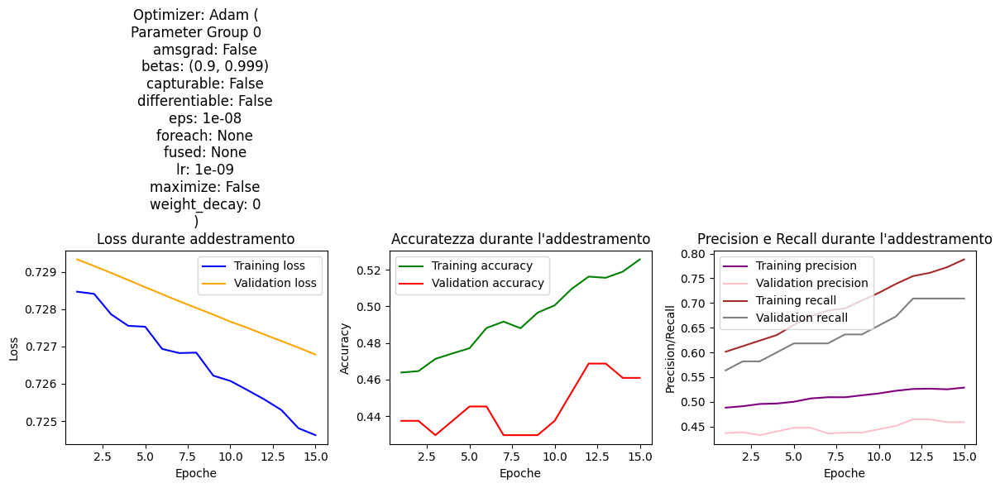

lr: 1e-10, wd: 0

Epoca n°0

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°1

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°2

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°3

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°4

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°5

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°6

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°7

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°8

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°9

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°10

Precision: 0, Recall: 0.0
406 0
444 0
Precision: 0, Recall: 0.0
57 0
55 0

Epoca n°11

Precision: 0, Recall: 0

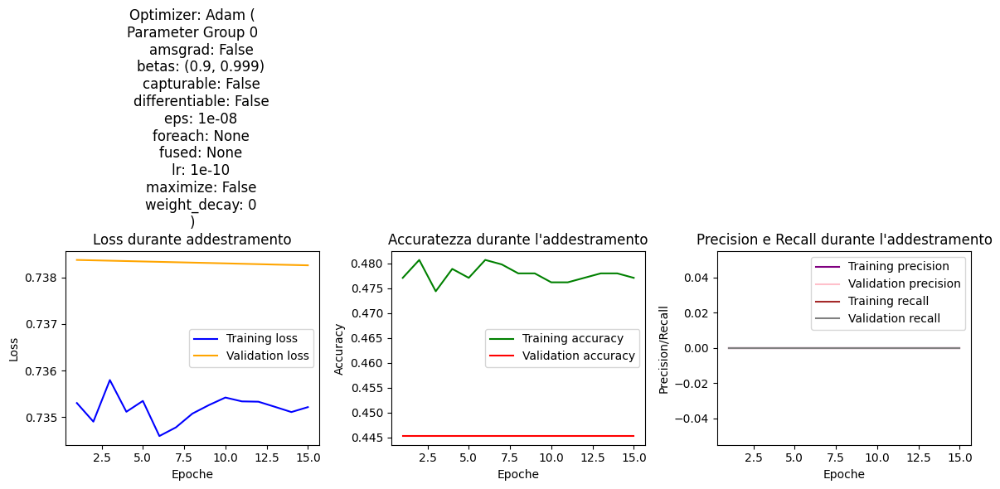

{'lr': 1e-05, 'momentum': 0, 'weight_decay': 0, 'scale': None, 'val_loss': 0.6348213106393814, 'val_acc': 0.734375}


In [ ]:
# ADAM

from itertools import product

DATA_DIR = "/content/drive/MyDrive/first_dataset"
BATCH_SIZE = 40
TRAIN_LIMIT = 800
NUM_EPOCHS = 15
DEVICE = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
MODELS_DIR = "/content/drive/MyDrive/canopies_models"

SAVE_MODELS = False

pos_weight = torch.tensor([2, 1]).to(device=DEVICE)

criterion = nn.BCEWithLogitsLoss() #(pos_weight=pos_weight)

lrs = [1e-5, 1e-6, 1e-7, 1e-8, 1e-9, 1e-10]
weight_decays = [0] # [0, 1e-4, 1e-3, 1e-2]


best_params = {
    "lr" : 0,
    "momentum" : 0,
    "weight_decay" : 0,
    "scale" : 0,
    "val_loss" : 10,
    "val_acc" : 0
}

train_losses_ = []
val_losses_ = []
train_accs_ = []
val_accs_ = []


for lr, weight_decay in list(product(lrs, weight_decays)):

    print(f"lr: {lr}, wd: {weight_decay}")

    torch.cuda.empty_cache()

    model = LeNet(num_classes=2).to(DEVICE)
    optimizer = optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

    train_losses, val_losses, train_accs, val_accs = train_model(
                train_loader,
                val_loader,
                model,
                optimizer,
                criterion,
                NUM_EPOCHS,
                MODELS_DIR,
                DEVICE,
                SAVE_MODELS
            )


    train_losses_.append(train_losses[-1])
    val_losses_.append(val_losses[-1])
    train_accs_.append(train_accs[-1])
    val_accs_.append(val_accs[-1])

    if (val_losses[-1] <= best_params["val_loss"] and val_accs[-1] >= best_params["val_acc"]):
        best_params["lr"] = lr
        best_params["weight_decay"] = weight_decay
        best_params["scale"] = None   # scale
        best_params["val_loss"] = val_losses[-1]
        best_params["val_acc"] = val_accs[-1]

print(best_params)

### main


Epoca n°0

Precision: 0.6385542168674698, Recall: 0.828125
83 120
44 212
Precision: 0.6904761904761905, Recall: 0.8787878787878788
15 13
4 29

Epoca n°1

Precision: 0.6745562130177515, Recall: 0.890625
93 110
28 228
Precision: 0.6764705882352942, Recall: 0.696969696969697
17 11
10 23

Epoca n°2

Precision: 0.6957928802588996, Recall: 0.83984375
109 94
41 215
Precision: 0.6739130434782609, Recall: 0.9393939393939394
13 15
2 31

Epoca n°3

Precision: 0.7012195121951219, Recall: 0.8984375
105 98
26 230
Precision: 0.6808510638297872, Recall: 0.9696969696969697
13 15
1 32

Epoca n°4

Precision: 0.7005988023952096, Recall: 0.9140625
103 100
22 234
Precision: 0.7142857142857143, Recall: 0.9090909090909091
16 12
3 30

Epoca n°5

Precision: 0.7133956386292835, Recall: 0.89453125
111 92
27 229
Precision: 0.7142857142857143, Recall: 0.9090909090909091
16 12
3 30

Epoca n°6

Precision: 0.7267080745341615, Recall: 0.9140625
115 88
22 234
Precision: 0.7142857142857143, Recall: 0.9090909090909091
16

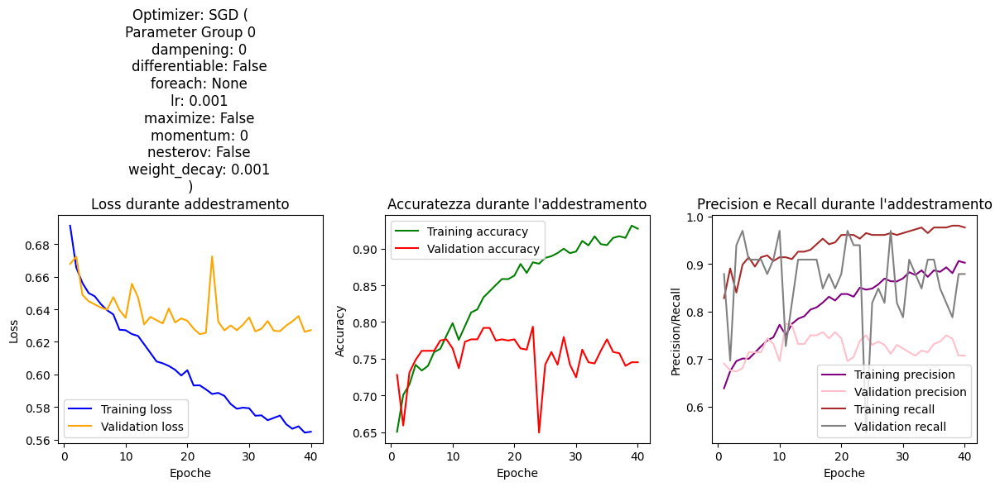

In [15]:
# scala 1.5

BATCH_SIZE = 40
NUM_EPOCHS = 40

SAVE_MODELS = False

criterion = nn.BCEWithLogitsLoss()

lr = 0.001
momentum = 0
weight_decay =  0.001

train_losses_ = []
val_losses_ = []
train_accs_ = []
val_accs_ = []

torch.cuda.empty_cache()

model = LeNet(num_classes=2).to(DEVICE)
optimizer = optim.SGD(model.parameters(), lr=lr, weight_decay=weight_decay, momentum=momentum)

train_losses, val_losses, train_accs, val_accs = train_model(
            train_loader,
            val_loader,
            model,
            optimizer,
            criterion,
            NUM_EPOCHS,
            MODELS_DIR,
            DEVICE,
            SAVE_MODELS
        )

train_losses_.append(train_losses[-1])
val_losses_.append(val_losses[-1])
train_accs_.append(train_accs[-1])
val_accs_.append(val_accs[-1])

In [ ]:
save_path = '/content/drive/MyDrive/canopies_models/main/modello.pth'

torch.save(model.state_dict(), save_path)

## Evaluation

In [17]:
def eval_model(model, data_loaders, criterion, device):
    model.eval()
    true_preds, num_preds = 0., 0.

    acc_train, loss_train, cm_train, precision_train, recall_train = test(data_loaders[0], model, criterion, device)
    acc_val, loss_val, cm_val, precision_val, recall_val = test(data_loaders[1], model, criterion, device)
    acc_test, loss_test, cm_test, precision_test, recall_test = test(data_loaders[2], model, criterion, device)

    print(f"Accuracy on Train: {acc_train*100:.2f}%, Loss: {loss_train:.2f}")
    print(f"Precision on Train: {precision_train:.2f}, Recall on Train: {recall_train:.2f}")

    print(f"Accuracy on Validation: {acc_val*100:.2f}%, Loss: {loss_val:.2f}")
    print(f"Precision on Validation: {precision_val:.2f}, Recall on Validation: {recall_val:.2f}")

    print(f"Accuracy on Test: {acc_test*100:.2f}%, Loss: {loss_test:.2f}")
    print(f"Precision on Test: {precision_test:.2f}, Recall on Test: {recall_test:.2f}")

    return cm_train, cm_val, cm_test

In [ ]:
%%script false --no-raise-error

# testa tutti i modelli salvati

RANDOM_SEED = 42
IMAGE_HEIGHT = IMAGE_WIDTH = 300

DATA_DIR = "/content/drive/MyDrive/first_dataset"
DEVICE = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

BATCH_SIZE = 32
NUM_WORKERS = 2
TRAIN_LIMIT = 500

criterion = nn.BCEWithLogitsLoss()

transform = torchvision.transforms.Compose(
    [
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Resize((IMAGE_HEIGHT, IMAGE_WIDTH), antialias=True),
    ]
)
_, _, _, train_dataset = get_loaders(
    data_dir = DATA_DIR,
    batch_size = BATCH_SIZE,
    train_percentage=0.7,
    val_percentage=0.1,
    transform=transform,
    num_workers=NUM_WORKERS,
    train_limit=TRAIN_LIMIT,
    random_seed=RANDOM_SEED,
    scale = None
)

mean, std = get_mean_std(train_loader)

transform = torchvision.transforms.Compose(
    [
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Resize((IMAGE_HEIGHT, IMAGE_WIDTH), antialias=True),
        torchvision.transforms.Normalize(mean=mean, std=std)
    ]
)

train_loader, val_loader, test_loader, _ = get_loaders(
    data_dir = DATA_DIR,
    batch_size = BATCH_SIZE,
    train_percentage=0.7,
    val_percentage=0.1,
    transform=transform,
    num_workers=NUM_WORKERS,
    train_limit=TRAIN_LIMIT,
    random_seed=RANDOM_SEED,
    scale = None
)

models_folder = "/content/drive/MyDrive/canopies_models/seed_42"
model_files = os.listdir(models_folder)

# Itera attraverso i file dei modelli
for model_file in model_files:
    if model_file.endswith(".pth"):
        model_path = os.path.join(models_folder, model_file)

        model = LeNet().to(DEVICE)  # Sostituisci con la definizione del tuo modello
        model.load_state_dict(torch.load(model_path, map_location=DEVICE)['model_state_dict'])

        # Esegui eval_model sul modello
        print("\n", model_file)
        cm_train, cm_val, cm_test = eval_model(model, [train_loader, val_loader, test_loader], criterion, DEVICE)

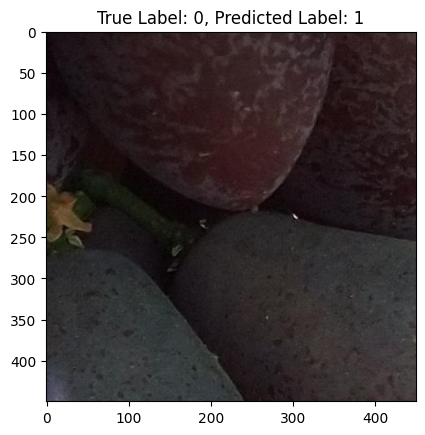

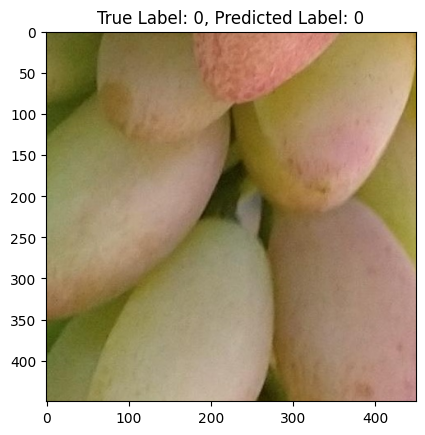

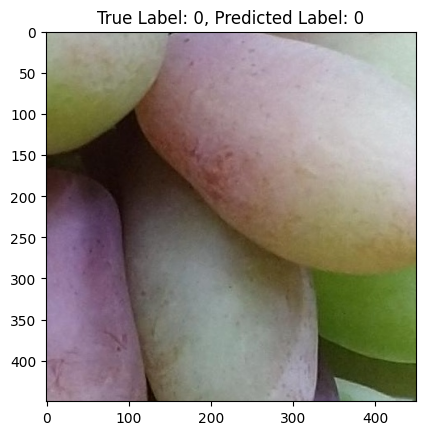

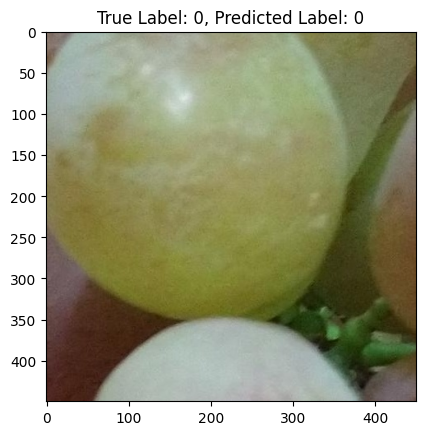

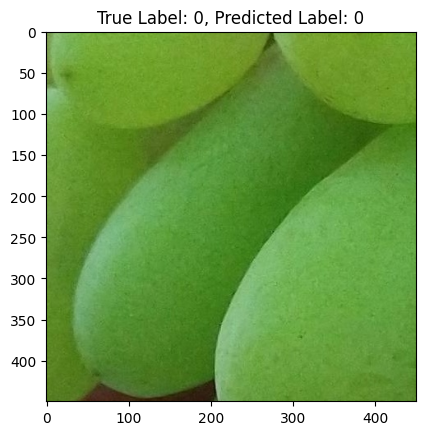

...

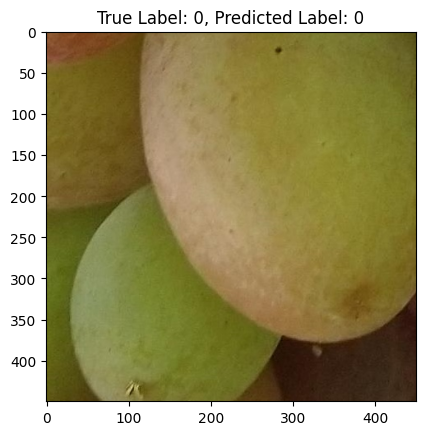

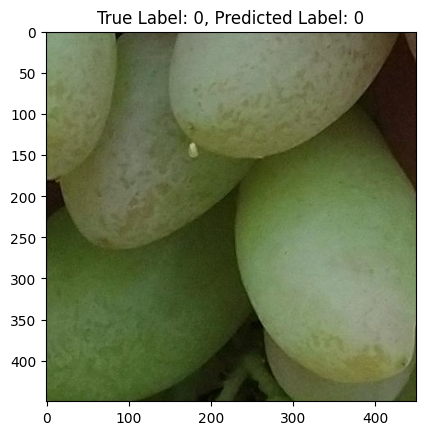

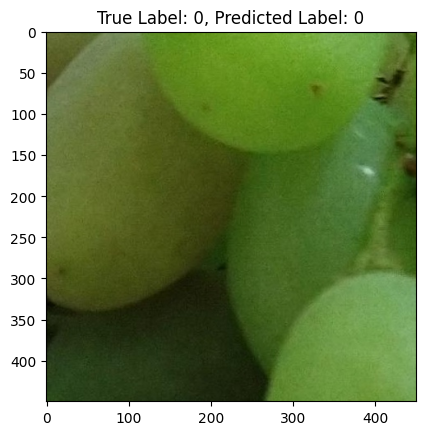

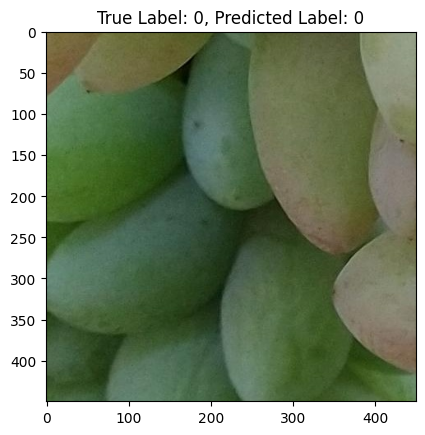

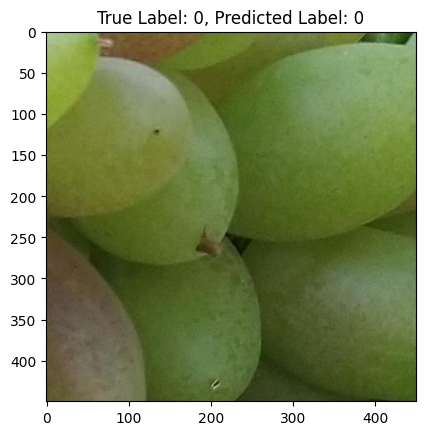

In [18]:
import matplotlib.pyplot as plt
import numpy as np

invTrans = transforms.Compose([ transforms.Normalize(mean = [ 0., 0., 0. ],
                                                     std = [ 1/std[0], 1/std[1], 1/std[2] ]),
                                transforms.Normalize(mean = [ -mean[0], -mean[1], -mean[2] ],
                                                     std = [ 1., 1., 1. ]),
                               ])

# inv_tensor = invTrans(inp_tensor)

# visualizzazione delle immagini con etichetta e predizione
def visualize_predictions(loader, model, device, limit=150):
    model.eval()

    count = 0
    with torch.no_grad():
        for data, targets in loader:
            data = data.to(device=device)
            targets = targets.numpy()  # Converti le etichette in un array NumPy
            predictions = model(data)
            predictions = predictions.argmax(dim=1).cpu().numpy()  # Converti le predizioni in un array NumPy
            for i in range(len(data)):
                tensor = data[i]
                tensor_unnorm = invTrans(tensor)
                image = tensor_unnorm.permute(1, 2, 0).cpu().numpy()  # Trasforma il tensore in un array NumPy per la visualizzazione
                plt.imshow(image)
                true_label = targets[i]
                predicted_label = predictions[i]
                plt.title(f"True Label: {true_label}, Predicted Label: {predicted_label}")
                plt.show()

                count += 1
                if count >= limit:
                    return

visualize_predictions(test_loader, model, DEVICE)

<Axes: >

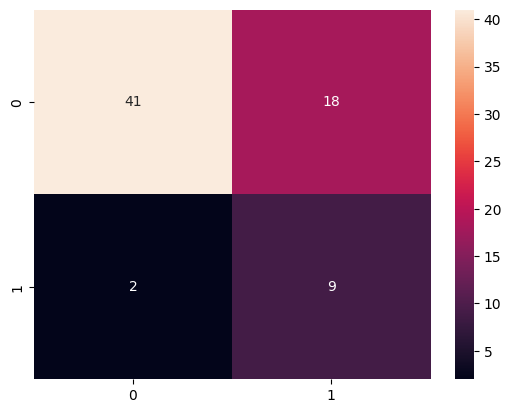

In [ ]:
import seaborn as sns

cm_train, cm_val, cm_test = eval_model(model, [train_loader, val_loader, test_loader], criterion, DEVICE)

sns.heatmap(cm_test, annot=True)

Precision: 0.8873239436619719, Recall: 0.984375
171 32
4 252
Precision: 0.7073170731707317, Recall: 0.8787878787878788
16 12
4 29
Precision: 0.34615384615384615, Recall: 0.8181818181818182
42 17
2 9
Accuracy on Train: 92.50%, Loss: 0.56
Precision on Train: 0.89, Recall on Train: 0.98
Accuracy on Validation: 74.52%, Loss: 0.63
Precision on Validation: 0.71, Recall on Validation: 0.88
Accuracy on Test: 75.69%, Loss: 0.64
Precision on Test: 0.35, Recall on Test: 0.82


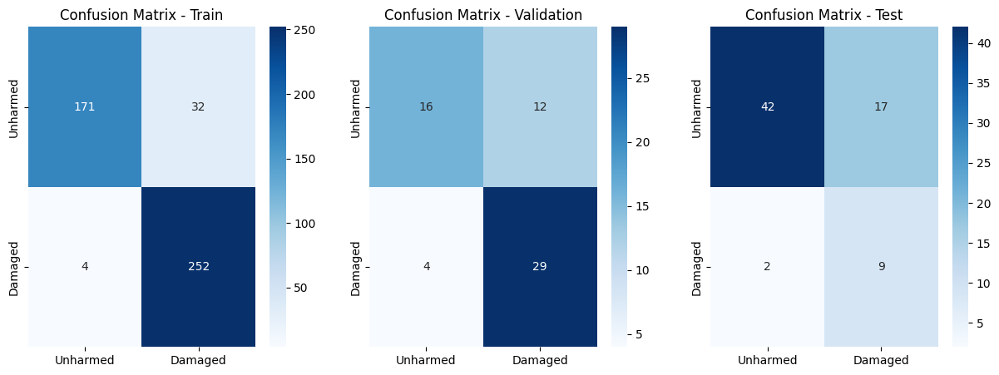

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

cm_train, cm_val, cm_test = eval_model(model, [train_loader, val_loader, test_loader], criterion, DEVICE)

class_names = ["Unharmed", "Damaged"]

fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Train
sns.heatmap(cm_train, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names, ax=axes[0])
axes[0].set_title('Confusion Matrix - Train')

# Validation
sns.heatmap(cm_val, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names, ax=axes[1])
axes[1].set_title('Confusion Matrix - Validation')

# Test
sns.heatmap(cm_test, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names, ax=axes[2])
axes[2].set_title('Confusion Matrix - Test')

# Mostra il grafico
plt.show()

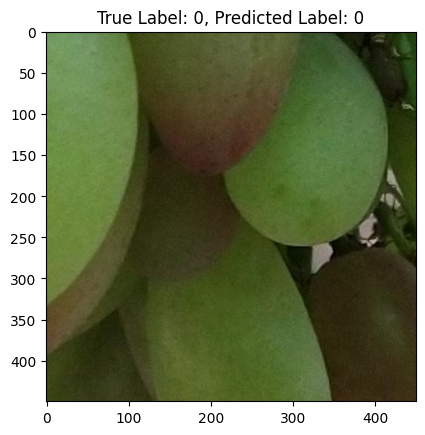

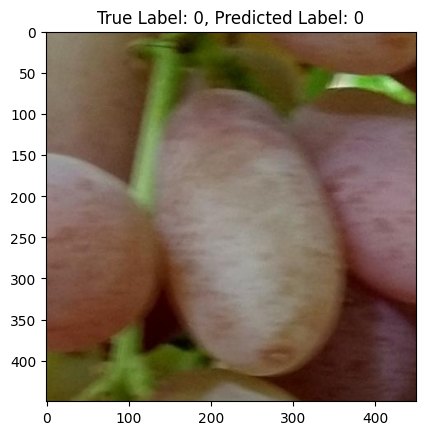

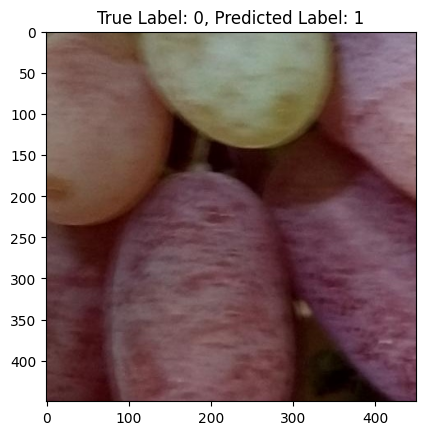

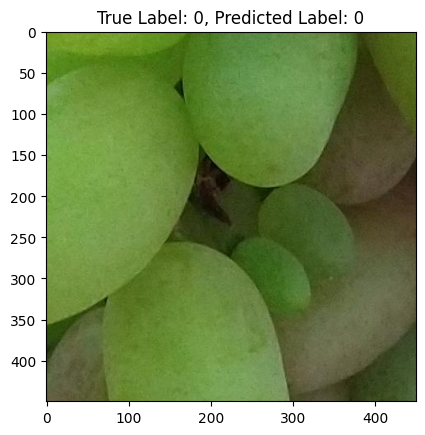

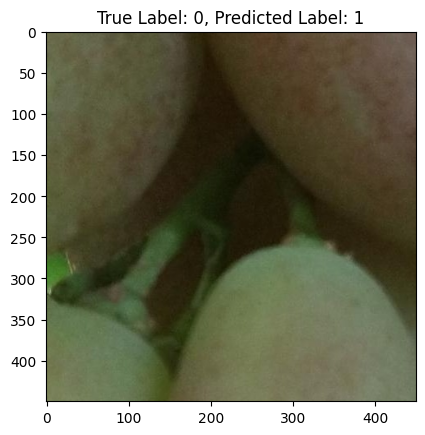

...

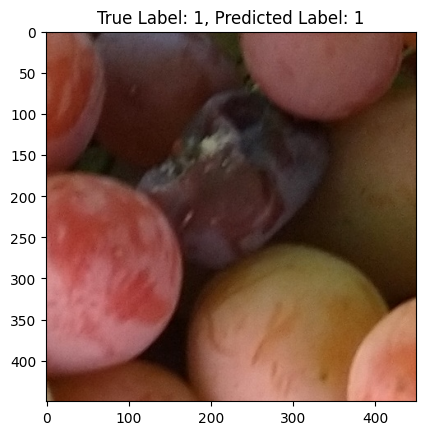

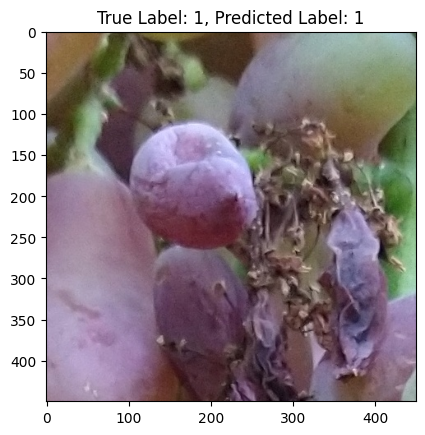

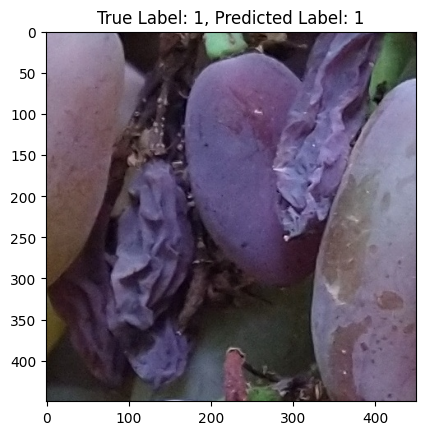

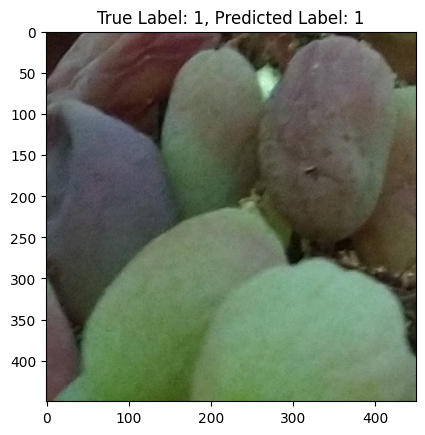

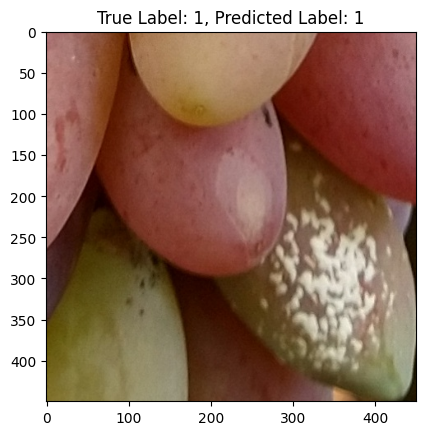

In [ ]:
visualize_predictions(val_loader, model, DEVICE)